**Problem Statement:**

Given a dataset containing credit card transaction information of 8950 customers, including various attributes such as balance, purchase frequency, credit limit, etc., the goal of this project is to perform clustering analysis to identify distinct segments or groups of customers based on their transaction behavior. The clustering analysis aims to uncover patterns and insights within the dataset, which can then be utilized for targeted marketing strategies, personalized customer services, and risk assessment.

The project involves the following steps:

1. **Data Preprocessing:** Cleaning and preprocessing the dataset to handle missing values and ensure data quality.

2. **Exploratory Data Analysis (EDA):** Conducting univariate, bivariate, and multivariate analysis to gain insights into the distribution and relationships among different attributes.

3. **Clustering Model Implementation:** Implementing various clustering algorithms such as K-means, Mini Batch K-means, Gaussian Mixture Model (GMM), Mean Shift, Affinity Propagation, BIRCH, DBSCAN, and Hierarchical Clustering to partition the dataset into meaningful clusters.

4. **Comparative Analysis:** Comparing the performance of different clustering models based on evaluation metrics and interpretability of results.

5. **Dimension Reduction:** Utilizing dimension reduction techniques such as Principal Component Analysis (PCA) and T-distributed Stochastic Neighbor Embedding (t-SNE) to visualize high-dimensional data and potentially improve clustering performance.

6. **Clustering Analysis:** Analyzing the clusters generated by the models to understand the characteristics and behaviors of each segment of customers.

By accomplishing these objectives, the project aims to provide actionable insights to businesses for better understanding their customer base, optimizing marketing strategies, and enhancing customer satisfaction and retention.

**Importing Necessary Libraries**

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from termcolor import colored

from sklearn import set_config
from sklearn.manifold import TSNE
from sklearn.impute import KNNImputer
from sklearn.decomposition import PCA
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.mixture import GaussianMixture, BayesianGaussianMixture
from sklearn.metrics import silhouette_score, calinski_harabasz_score
from sklearn.cluster import KMeans, MiniBatchKMeans, MeanShift, estimate_bandwidth, AffinityPropagation, Birch, DBSCAN, OPTICS, AgglomerativeClustering

import scipy.cluster.hierarchy as sch

from yellowbrick.cluster import KElbowVisualizer

In [ ]:
from itertools import product

In [ ]:
pip install kneed

In [ ]:
from kneed import KneeLocator

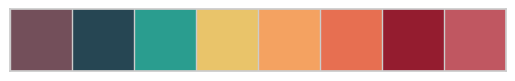

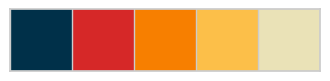

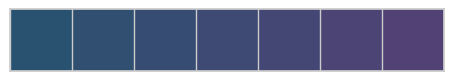

In [ ]:
def my_palette(my_colors):
    myPalette = sns.set_palette(sns.color_palette(my_colors))
    sns.palplot(sns.color_palette(my_colors), size=0.8)
    plt.tick_params(axis='both', labelsize=0, length = 0)

# Implementing FONT for the titles of the plots
FONT = {'fontsize':25, 'fontstyle':'normal', 'fontfamily':'Georgia', 'backgroundcolor':'#B41B10', 'color':'#E4C09E'}

# Creating color palette
colors1 = ["#734F5A", "#264653", "#2A9D8F", "#E9C46A", "#F4A261", "#E76F51", "#941C2F", "#C05761"]
colors2 = ["#003049","#D62828","#F77F00","#FCBF49","#EAE2B7"]
dark_colors = ["#295270", "#304F71", "#374C72", "#3E4A73", "#444773", "#4B4474", "#524175"]

for color in [colors1, colors2, dark_colors]:
    my_palette(color)

**Reading the dataset**

In [ ]:
df=pd.read_csv("Customer_Data.csv")

In [ ]:
df.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


**CUST_ID**: Unique customer identification number.        
**BALANCE**: Total amount owed or owed to a vendor, in local currency.     
**BALANCE_FREQUENCY**: Score indicating how frequently the balance is updated (0-1).         
**PURCHASES:** Total amount of purchases made from the account.      
**ONEOFF_PURCHASES**: Maximum purchase amount made in one transaction.       
**INSTALLMENTS_PURCHASES**: Total amount of purchases made in installments.      
**CASH_ADVANCE**: Cash in advance taken by the user.      
PURCHASES_FREQUENCY: Score indicating how frequently purchases are made (0-1).         
**ONEOFF_PURCHASES_FREQUENCY**: Frequency of non-regular plan purchases (0-1).     
**PURCHASES_INSTALLMENTS_FREQUENCY**: Frequency of installment purchases (0-1).    
**CASH_ADVANCE_FREQUENCY**: Frequency of cash advances (0-1).      
**CASH_ADVANCE_TRX**: Number of cash advance transactions in the last 12 months.             
**PURCHASES_TRX**: Number of purchase transactions in the last 12 months.    
**CREDIT_LIMIT**: Maximum amount customers can borrow from their credit card.        
**PAYMENTS**: Total payments made to the credit card in the last 12 months.            
**MINIMUM_PAYMENTS**: Minimum payments required in the last 12 months.        
**PRC_FULL_PAYMENT**: Percentage of months with full payment in the last 12 months.            
**TENURE:** Duration of credit card usage in months.

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

We have 8950 data points, customers, or rows.        
We have 18 columns or features.       
CREDIT_LIMIT seems to have a missing point or a missing value. We're gonna' check this.       
MINIMUM_PAYMENTS seems to have some missing values. We're gonna' check this.      
All columns are float64 or int64 but CUST_ID column is object.
Other columns look fine.      
As a result, the file contains 18 features that detail the spending and payment behaviors of approximately 9,000 credit card users over the last six months. Each row represents an individual customer.      

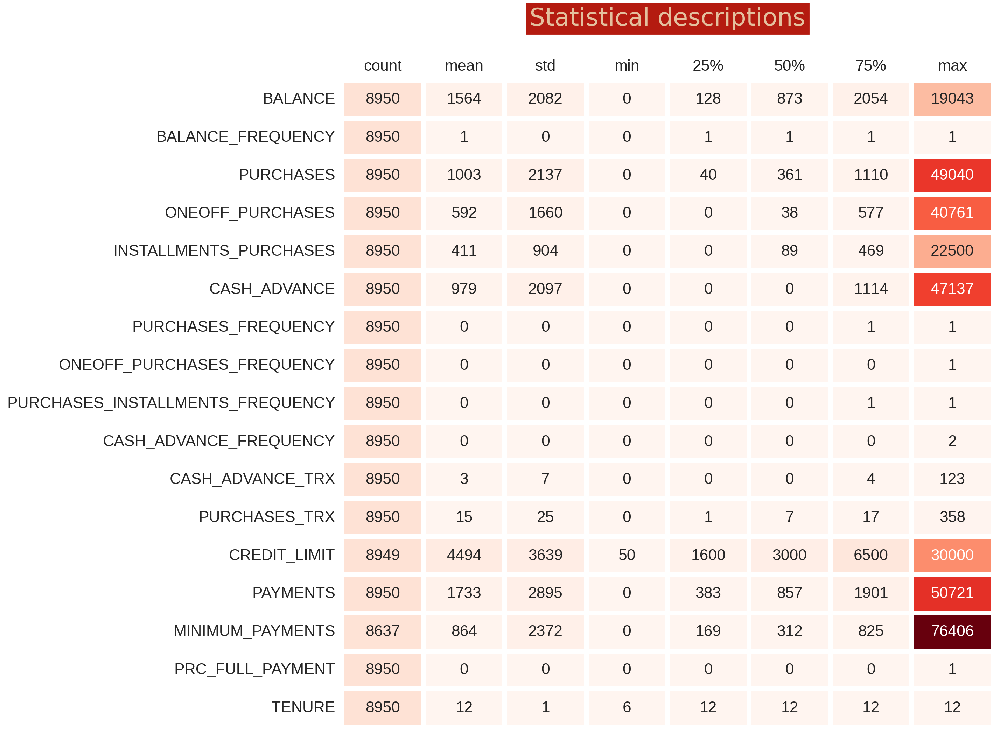

In [ ]:
# Only selecting this type of columns for more details,
desc_cust = df.select_dtypes(include=['int64','float64']).describe().T

# And make it as a dataframe again (once we did this before),
desc_cust_df = pd.DataFrame(index=desc_cust.index, columns=desc_cust.columns, data=desc_cust )

# Defining the size and the resolution would be,
f, ax = plt.subplots(figsize=(12,12), dpi=200)

# We define this as a Heatmap,
sns.heatmap(desc_cust_df, annot=True, cmap="Reds", fmt='.0f', ax=ax, linewidths=5, cbar=False, annot_kws={"size": 16})

# Other settings,
ax.xaxis.set_ticks_position('top')

plt.tick_params(left=False, top=False)

plt.xticks(size=16)
plt.yticks(size=16)

plt.title("Statistical descriptions", pad=50, x=0.50, y=1.01, fontdict=FONT)

plt.show()

In [ ]:
df = df.drop('CUST_ID', axis=1)

In [ ]:
# Highlighting cells that are not equal to zero, indicating the presence of missing values,
# The coloring part,
def highlight_cells(val):
    f_color = '#D63226' if val != 0 else ''  # This is red, text.
    bg_color = '#BDE0FE' if val != 0 else ''   # This is blue, background.
    w_font = 'bold'
    return 'background-color: {}; color: {}; font-weight: {}'.format(bg_color, f_color, w_font)

# Check missing values,
# The values part,
is_nan = df.isna().sum().to_frame(name='Number_of_NaN')
is_nan.insert(1,'Percent(%)', [round(x/df.shape[0]*100,2) for x in is_nan.Number_of_NaN])
is_nan.style.applymap(highlight_cells)

,Number_of_NaN,Percent(%)
BALANCE,0,0.000000
BALANCE_FREQUENCY,0,0.000000
PURCHASES,0,0.000000
ONEOFF_PURCHASES,0,0.000000
INSTALLMENTS_PURCHASES,0,0.000000
CASH_ADVANCE,0,0.000000
PURCHASES_FREQUENCY,0,0.000000
ONEOFF_PURCHASES_FREQUENCY,0,0.000000
PURCHASES_INSTALLMENTS_FREQUENCY,0,0.000000
CASH_ADVANCE_FREQUENCY,0,0.000000


In [ ]:
df = df.drop(df[df.CREDIT_LIMIT.isna()].index, axis=0)

**Cleaning and pre-processing the DataFrame**

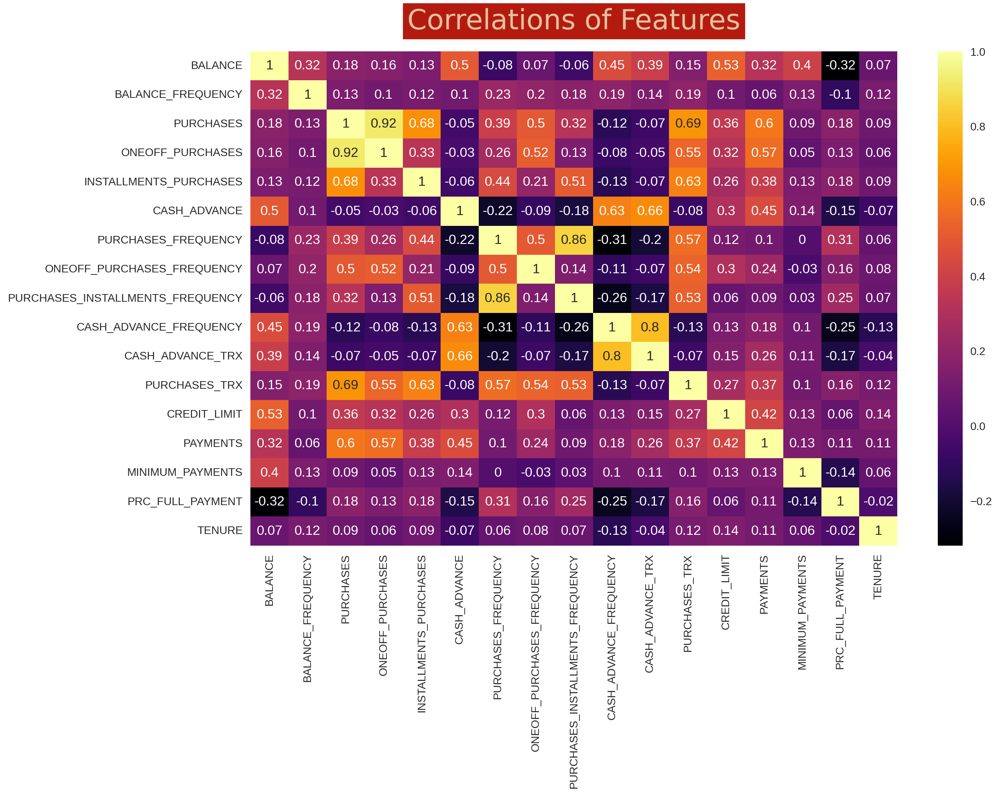

In [ ]:
# Set the size and resolution,
plt.figure(figsize=(13,8), dpi=200)

# Using Heatmap for checking the correlations,
sns.heatmap(round(df.corr(),2), annot=True, cmap='inferno')

plt.title("Correlations of Features", pad=20, fontdict=FONT)

#plt.savefig("D:\\IMT\\4- Machine Learning\\37- Clustering (Project5)\\Correlations.jpg")

plt.show()

ONEOFF_PURCHASES exhibits a high correlation with PURCHASES.      
PURCHASES_INSTALLMENTS_FREQUENCY exhibits a high correlation with PURCHASES_FREQUENCY.           
Also, CASH_ADVANCE_TRX exhibits a high correlation with CASH_ADVANCE_FREQUENCY.         
Other correlations can also be observed directly from the heatmap as well.       


In [ ]:
# Defining the imputer,
imputer = KNNImputer()

# Fit it to the df,
imputer.fit(df)

# Transforming the df,
df1 = pd.DataFrame(imputer.transform(df), columns=df.columns)

# Printing the results
print(colored(f'Missing Values (before the imputer): {df.isna().sum().sum()}', 'red'))
print(colored(f'Missing Values (after the imputer): {df1.isna().sum().sum()}', 'green'))

Missing Values (before the imputer): 313
Missing Values (after the imputer): 0


Duplicated Data:

In [ ]:
df1.duplicated().sum()

0

Noises

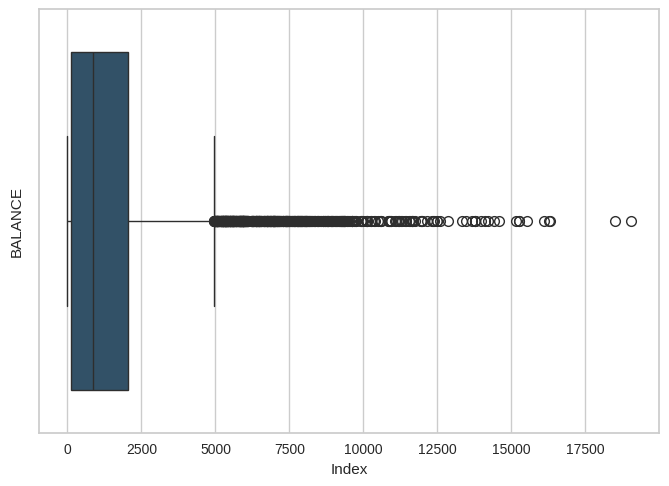

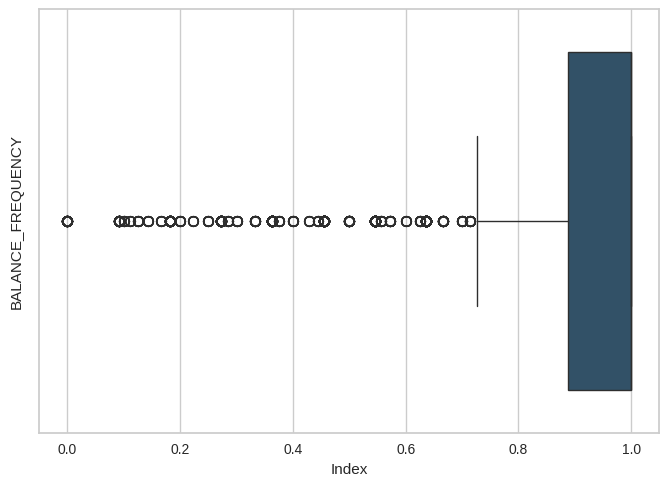

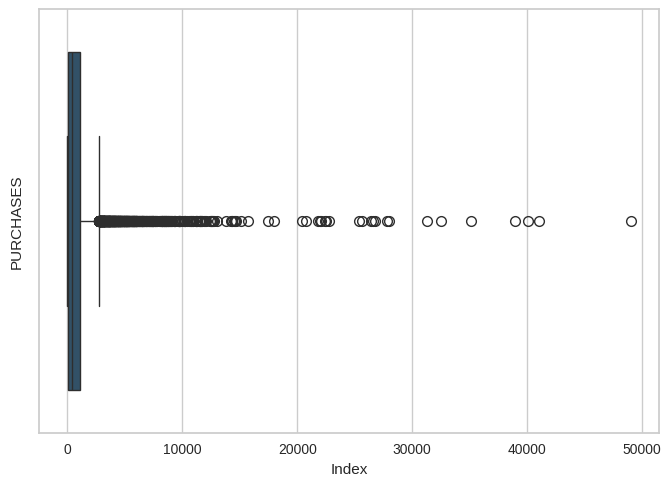

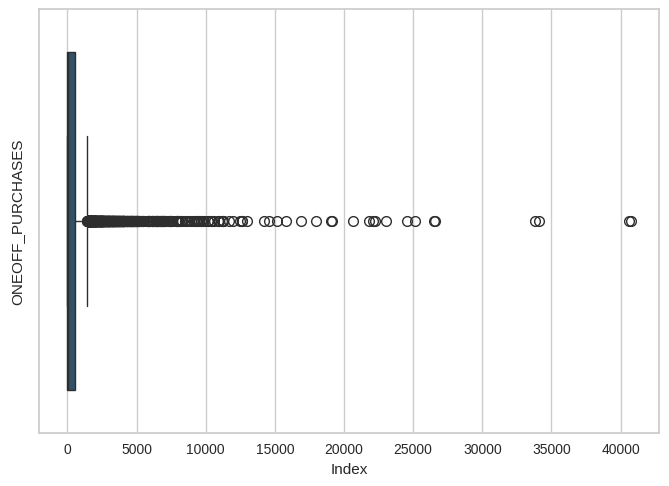

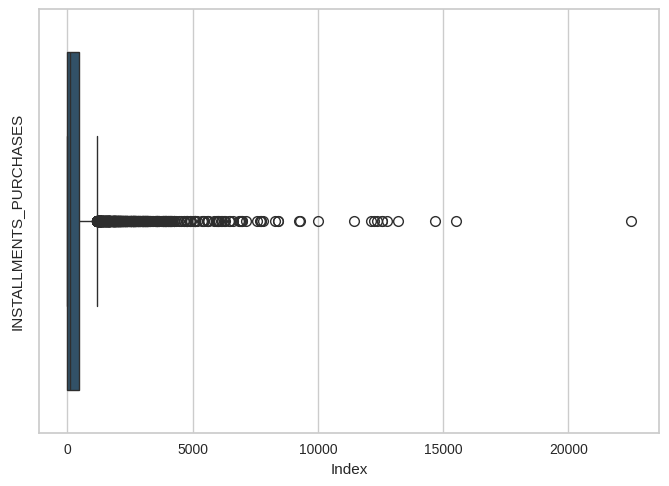

...

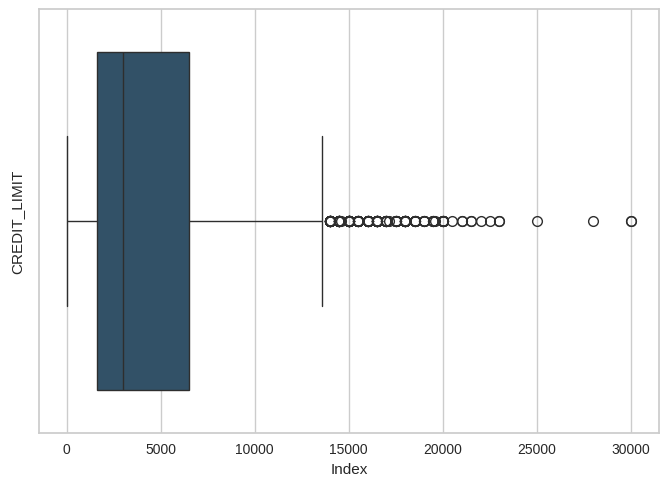

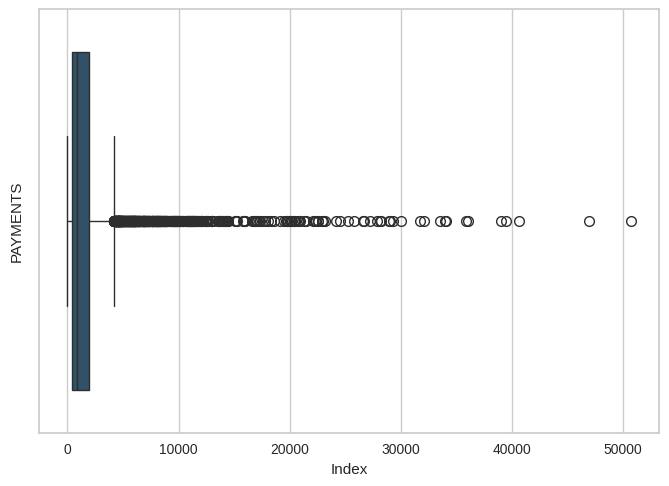

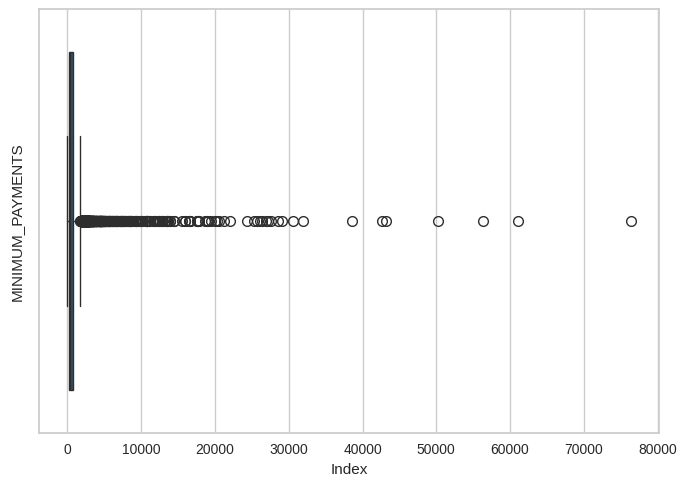

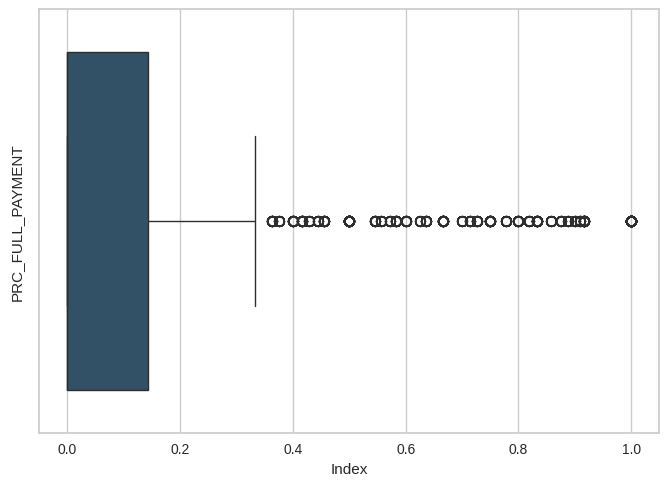

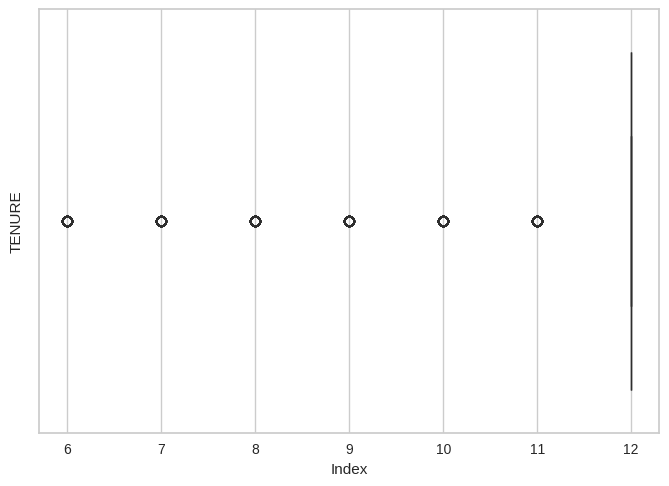

In [ ]:
for column in df1:
    plt.figure()
    sns.boxplot(data=df1, x=column)
    plt.xlabel('Index')
    plt.ylabel(column)
    plt.show()

 **DataFrame visualizations**

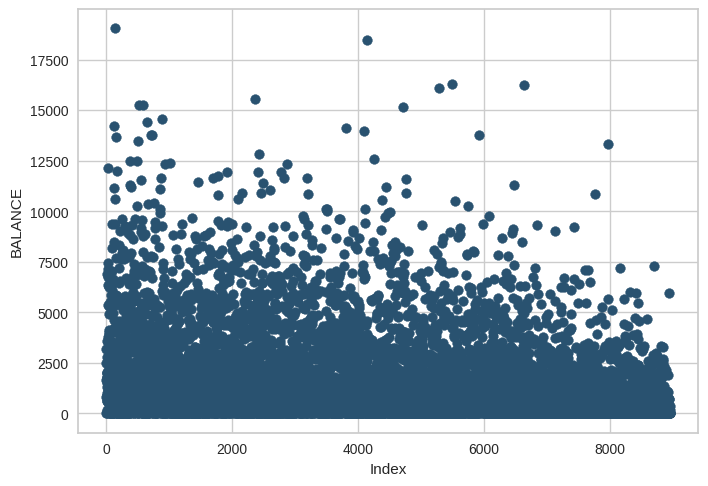

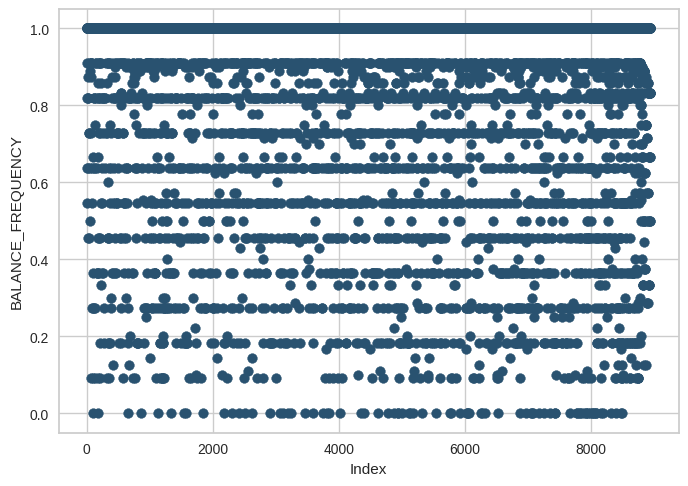

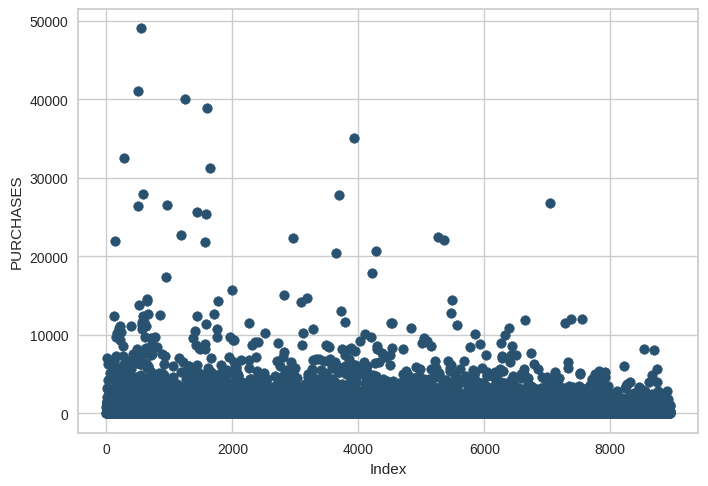

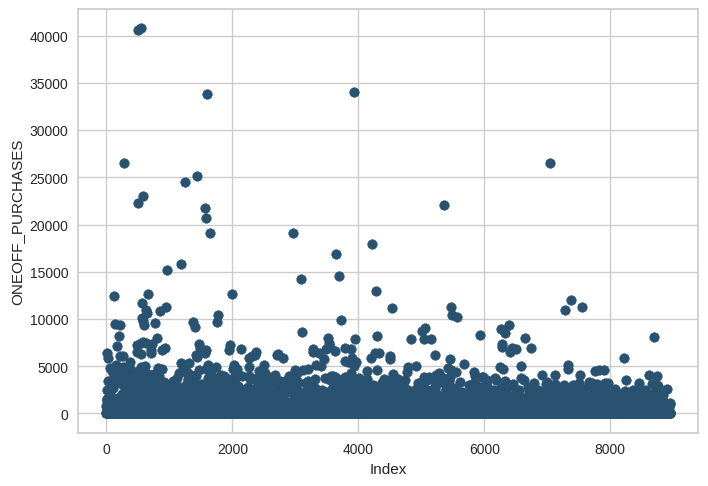

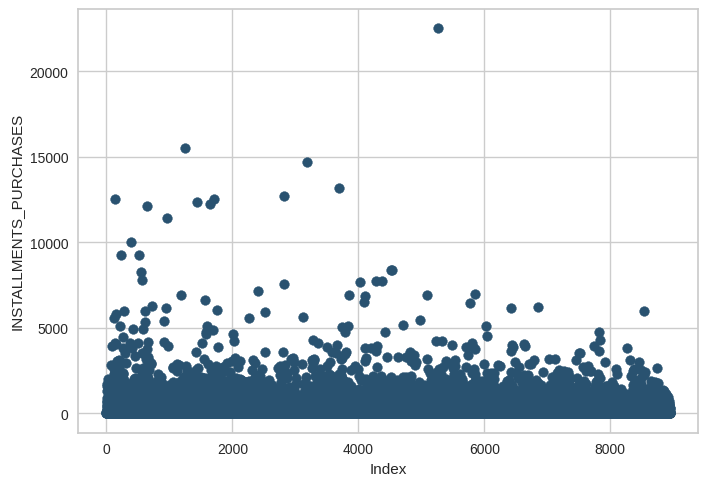

...

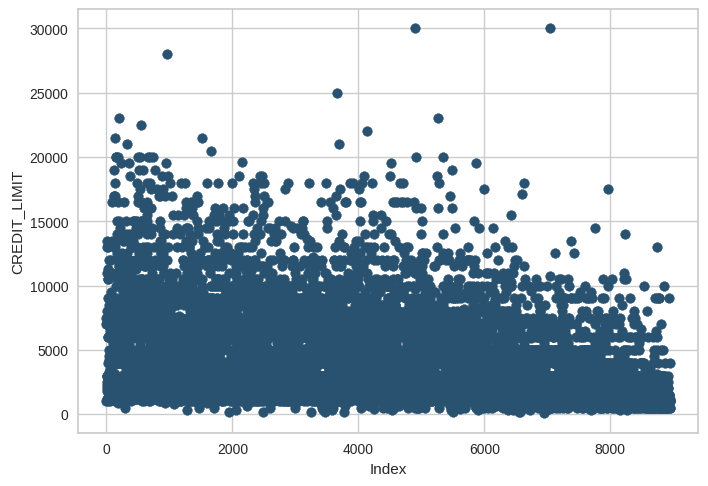

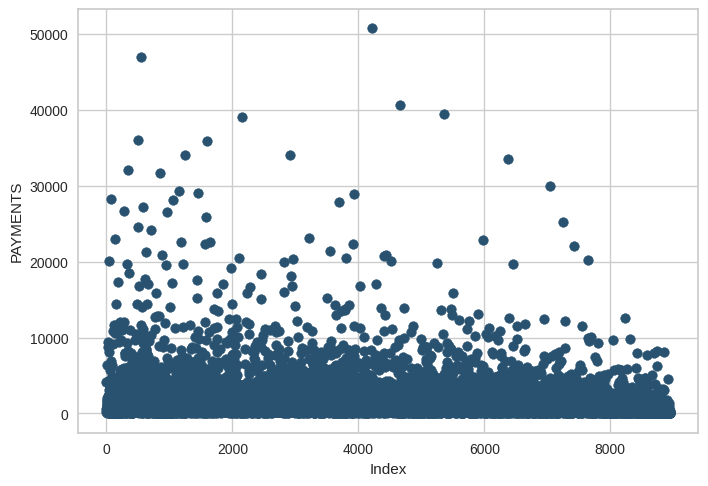

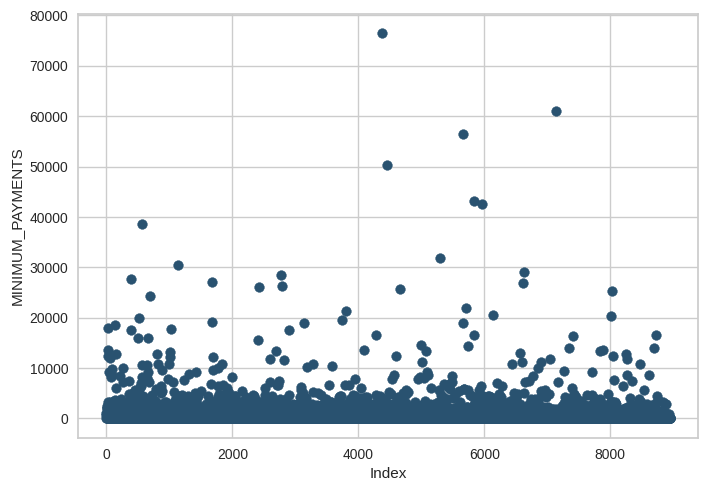

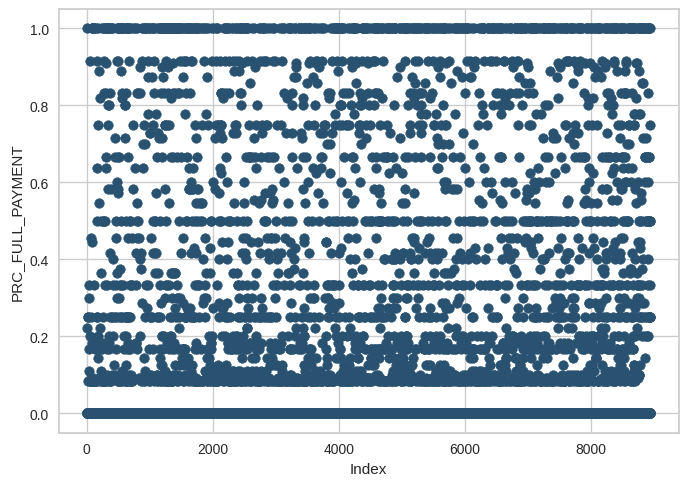

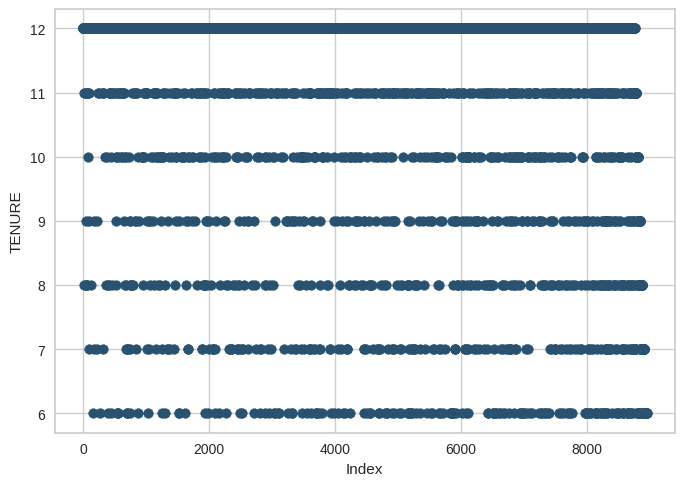

In [ ]:
for column in df1:
    plt.figure()
    plt.scatter(df1.index, df1[column])
    plt.xlabel('Index')
    plt.ylabel(column)
    plt.show()

We can observe the distributions and ranges one by one.        
Some columns appear to have outliers or noise, but we refrain from making any adjustments since the dataset revolves around credit card information and involves numerical values.          
Hence, no specific actions are taken at this point.

**Pattern recognition**

Univariate analysis

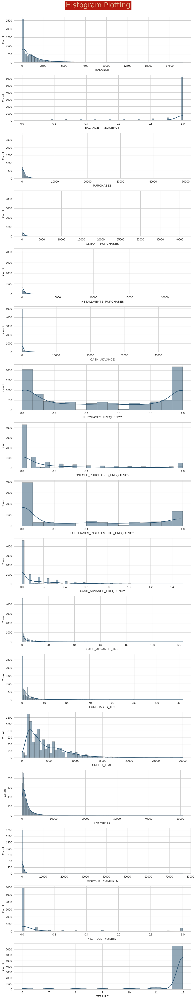

In [ ]:
fig, ax = plt.subplots(17, 1, figsize=(10,50))

for i, col in enumerate(df1):
    sns.histplot(df1[col], kde=True, ax=ax[i])

fig.suptitle('Histogram Plotting', y=1.001, **FONT)

fig.tight_layout()

plt.show()

Bivariate Analysis

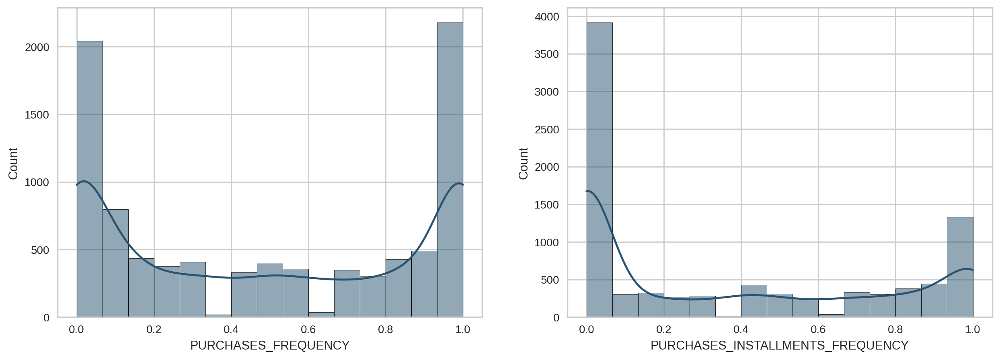

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(15,5), dpi=200)

for i,col in enumerate(['PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY']):
    sns.histplot(df1[col], kde=True,  ax=ax[i])

plt.show()

Multivariate Analysis

Already done heatmap

**Implementing clustering models**

initiate data standardization to ensure uniformity

In [ ]:
# For Standardizing,
scaler = StandardScaler().fit(df1)

df_trans = scaler.transform(df1)

df2 = pd.DataFrame(df_trans, columns = df1.columns)
df2

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,-0.732054,-0.249881,-0.424934,-0.356957,-0.349114,-0.466805,-0.806649,-0.678716,-0.707409,-0.675294,-0.476083,-0.511381,-0.960380,-0.529026,-0.303869,-0.525588,0.360541
1,0.786858,0.134049,-0.469584,-0.356957,-0.454607,2.605438,-1.221928,-0.678716,-0.917090,0.573949,0.110032,-0.591841,0.688601,0.818546,0.093483,0.234159,0.360541
2,0.447041,0.517980,-0.107716,0.108843,-0.454607,-0.466805,1.269742,2.673295,-0.917090,-0.675294,-0.476083,-0.109082,0.826016,-0.383857,-0.096095,-0.525588,0.360541
3,0.049015,-1.017743,0.231995,0.546123,-0.454607,-0.368678,-1.014290,-0.399383,-0.917090,-0.258882,-0.329554,-0.551611,0.826016,-0.598733,-0.201502,-0.525588,0.360541
4,-0.358849,0.517980,-0.462095,-0.347317,-0.454607,-0.466805,-1.014290,-0.399383,-0.917090,-0.675294,-0.476083,-0.551611,-0.905414,-0.364421,-0.259023,-0.525588,0.360541
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8944,-0.738015,0.517980,-0.333331,-0.356957,-0.132688,-0.466805,1.269742,-0.678716,1.179720,-0.675294,-0.476083,-0.350461,-0.960380,-0.486266,-0.342472,1.183844,-4.126919
8945,-0.742488,0.517980,-0.329174,-0.356957,-0.122869,-0.466805,1.269742,-0.678716,1.179720,-0.675294,-0.476083,-0.350461,-0.960380,-0.503445,-0.296819,-0.525588,-4.126919
8946,-0.740463,-0.185895,-0.402000,-0.356957,-0.294930,-0.466805,0.854463,-0.678716,0.760359,-0.675294,-0.476083,-0.390691,-0.960380,-0.570660,-0.328188,0.329128,-4.126919
8947,-0.745239,-0.185895,-0.469584,-0.356957,-0.454607,-0.449373,-1.221928,-0.678716,-0.917090,0.157536,-0.183026,-0.591841,-1.097795,-0.580581,-0.339546,0.329128,-4.126919


**K-means**          
K-Means clustering is a type of unsupervised machine learning algorithm that partitions a set of data points into k groups, where k is a predefined number. The algorithm assigns each data point to the group that has the closest mean value, also known as the centroid. The algorithm iterates until the centroids are stable and the groups are well-separated. K-Means clustering is useful for finding patterns and similarities in unlabeled data, such as customer segmentation, image compression, and anomaly detection

In [ ]:
kmeans_set = {'init':'random', 'n_init':10, 'max_iter':300, 'random_state':42}

Discover the optimal value for k in the clustering algorithm by examining the inertias list, which contains the inertia values for each selected k. The name variable denotes the clustering algorithm's identifier:

In [ ]:

List = []

for k in range(1,11): # 1 to 10 it is
    kmeans = KMeans(n_clusters=k, **kmeans_set)
    kmeans.fit(df2)
    List.append(kmeans.inertia_)

In [ ]:
def elbow_optimizer(List,name):
    kl = KneeLocator(range(1,11), List, curve='convex', direction="decreasing")
    plt.style.use("fivethirtyeight")
    sns.lineplot(x=range(1,11), y=List, color=dark_colors[0])
    plt.xticks(range(1,11))
    plt.xlabel('Number of Clusters', labelpad=20)
    plt.ylabel('Inertia / List', labelpad=20)
    plt.title(f"Elbow / Knee Point for {name}", y=1.09, fontdict=FONT)
    plt.axvline(x=kl.elbow, color=dark_colors[-1], label='axvline-fullheight', ls='--')
    plt.show()

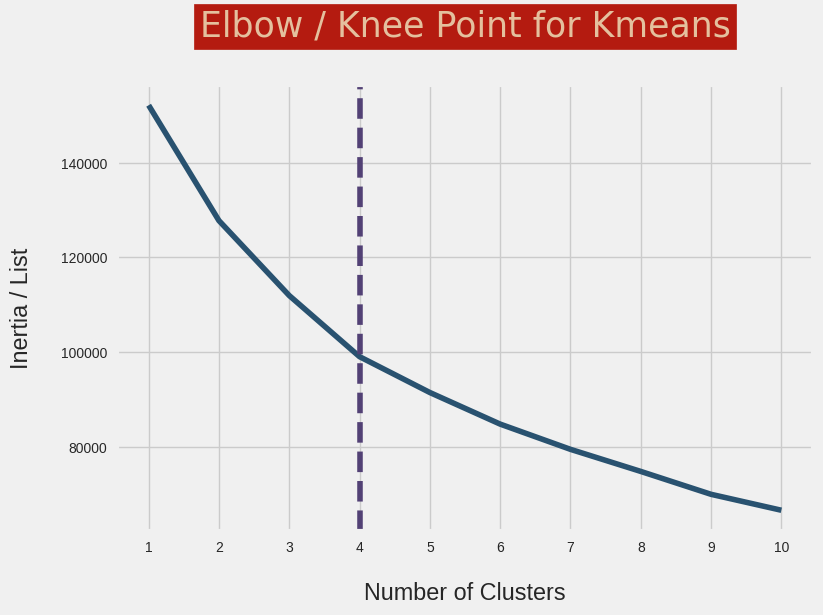

In [ ]:
elbow_optimizer(List, 'Kmeans')

According to the elbow method, the ideal number of clusters for the kmeans algorithm is determined to be 4

Subsequently, we validate this outcome using internal validation techniques. Silhouette_score and calinski_harabasz_score are employed for this internal validation process:

In [ ]:
silhouette_coef = []

for k in range(2,11): # 2, cause 1 doesn't make sense
    kmeans = KMeans(n_clusters=k, **kmeans_set)
    kmeans.fit(df2)
    score = silhouette_score(df2, kmeans.labels_)
    silhouette_coef.append(score)

In [ ]:
calinski_harabasz_coef = []

for k in range(2,11):
    kmeans = KMeans(n_clusters=k, **kmeans_set)
    kmeans.fit(df2)
    score = calinski_harabasz_score(df2, kmeans.labels_)
    calinski_harabasz_coef.append(score)

In [ ]:
def plot_evaluation(sh_score, ch_score, name, x=range(2,11)):
    fig, ax = plt.subplots(1,2,figsize=(15,7), dpi=200)
    ax[0].plot(x, sh_score, color=dark_colors[0], marker='o', ms=9, mfc=dark_colors[-1])
    ax[1].plot(x, ch_score, color=dark_colors[0], marker='o', ms=9, mfc=dark_colors[-1])
    ax[0].set_xlabel("Number of Clusters", labelpad=20)
    ax[0].set_ylabel("Silhouette Coefficient", labelpad=20)
    ax[1].set_xlabel("Number of Clusters", labelpad=20)
    ax[1].set_ylabel("Calinski Harabasz Coefficient", labelpad=20)
    plt.suptitle(f'Evaluate {name} Clustering',y=0.9, **FONT)
    plt.tight_layout(pad=3)
    plt.show()

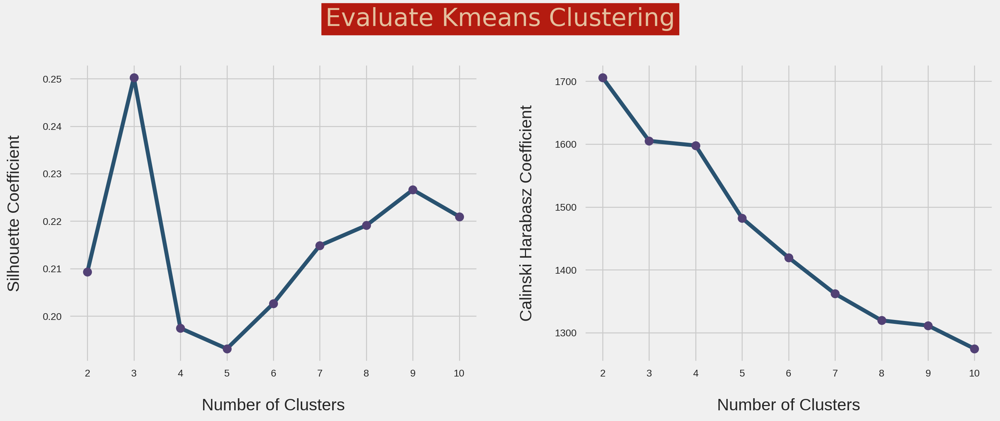

In [ ]:
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'Kmeans')

Based on the findings derived from the aforementioned graphs, both visual representations corroborate that the optimal number of clusters is 3.        
However, it is noteworthy that Calinski's graph dismisses the possibility of having 4 clusters.          
Consequently, we designate 3 as the optimal K and proceed to implement kmeans once more, specifying n_clusters=3

Establish a dictionary to store the results of clustering algorithms for the purpose of comparison:

In [ ]:
best_model = pd.DataFrame({'Model':[], 'Sil_score':[], 'CH_score':[], 'setting':[]})

Execute the K-Means algorithm with the parameter n_clusters set to 3:

In [ ]:
kmeans = KMeans(n_clusters=3, **kmeans_set).fit(df2)

In [ ]:
pred = kmeans.labels_

In [ ]:
centroids = kmeans.cluster_centers_
centroids = pd.DataFrame(data=centroids, columns = [df2.columns])
centroids.T


,0,1,2
BALANCE,0.303944,-0.367227,1.166323
BALANCE_FREQUENCY,0.439589,-0.179740,0.342575
PURCHASES,1.511614,-0.234509,-0.289383
ONEOFF_PURCHASES,1.268264,-0.206109,-0.207014
INSTALLMENTS_PURCHASES,1.243736,-0.175729,-0.303986
CASH_ADVANCE,-0.249556,-0.308897,1.377638
PURCHASES_FREQUENCY,1.141921,-0.066657,-0.641343
ONEOFF_PURCHASES_FREQUENCY,1.564646,-0.240889,-0.306603
PURCHASES_INSTALLMENTS_FREQUENCY,0.943199,-0.049147,-0.552346
CASH_ADVANCE_FREQUENCY,-0.361336,-0.333864,1.560896


Save the results of the kmeans algorithm:

In [ ]:
best_model.loc[len(best_model.index)] = [f"Kmeans", silhouette_score(df2,pred), calinski_harabasz_score(df2,pred), {"n_clusters":3, **kmeans_set}]

Transform the scaled centroids to their original scale:

In [ ]:
real_centroids = scaler.inverse_transform(centroids)
real_centroids = pd.DataFrame(data=real_centroids, columns = [df2.columns])
real_centroids.T

,0,1,2
BALANCE,2197.296209,800.275491,3992.310601
BALANCE_FREQUENCY,0.981438,0.834790,0.958467
PURCHASES,4233.043267,502.262838,385.018966
ONEOFF_PURCHASES,2697.663874,250.387735,248.886107
INSTALLMENTS_PURCHASES,1535.858626,252.196794,136.210395
CASH_ADVANCE,455.603491,331.157545,3868.069401
PURCHASES_FREQUENCY,0.948701,0.463653,0.233011
ONEOFF_PURCHASES_FREQUENCY,0.669259,0.130616,0.111012
PURCHASES_INSTALLMENTS_FREQUENCY,0.739333,0.344946,0.144960
CASH_ADVANCE_FREQUENCY,0.062830,0.068327,0.447509


Include the clusters column in the main dataframe (df2), and store the updated dataframe in a new one:

In [ ]:
df_result_kmeans = pd.concat([df1, pd.DataFrame(pred, columns=['cluster'])], axis = 1)
df_result_kmeans

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,1
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,2
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,1
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,379.829982,0.000000,12.0,1
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8944,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,1
8945,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,156.060050,0.000000,6.0,1
8946,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,1
8947,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,1


In [ ]:
def check_result(data):
    fig, axes = plt.subplots(1,2,figsize=(10,4))
    # Count of the clusters (using countplot),
    sns.countplot(data=data, x='cluster', ax=axes[0], palette=dark_colors[0:int(data.cluster.nunique())], saturation=1, edgecolor = "#1c1c1c", linewidth = 2)
    for container in axes[0].containers:
        axes[0].bar_label(container, label_type="center", padding=5, size=12, color="black", rotation=0,
        bbox={"boxstyle":"round", "pad":0.4, "facecolor":"#e0b583", "edgecolor":"#1c1c1c", "linewidth":2, "alpha":1})
    # Plotting the Pie plot,
    slices = data['cluster'].value_counts().sort_index().values
    activities = [var for var in data['cluster'].value_counts().sort_index().index]
    wedges, texts, autotexts = axes[1].pie(slices, labels=activities, shadow=True, autopct='%1.1f%%', textprops=dict(size=16, color="black"), pctdistance = 0.6, radius=1, colors = dark_colors[0:int(data.cluster.nunique())], wedgeprops=dict(edgecolor = "black", linewidth = 2),)
    plt.legend(wedges, data.cluster.value_counts().sort_index().index, title="Clusters", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1), edgecolor = "black")
    plt.suptitle(f'Count of Each Cluster', y=1.09, **FONT)
    plt.show()

<ipython-input-36-b259f0639748>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=data, x='cluster', ax=axes[0], palette=dark_colors[0:int(data.cluster.nunique())], saturation=1, edgecolor = "#1c1c1c", linewidth = 2)


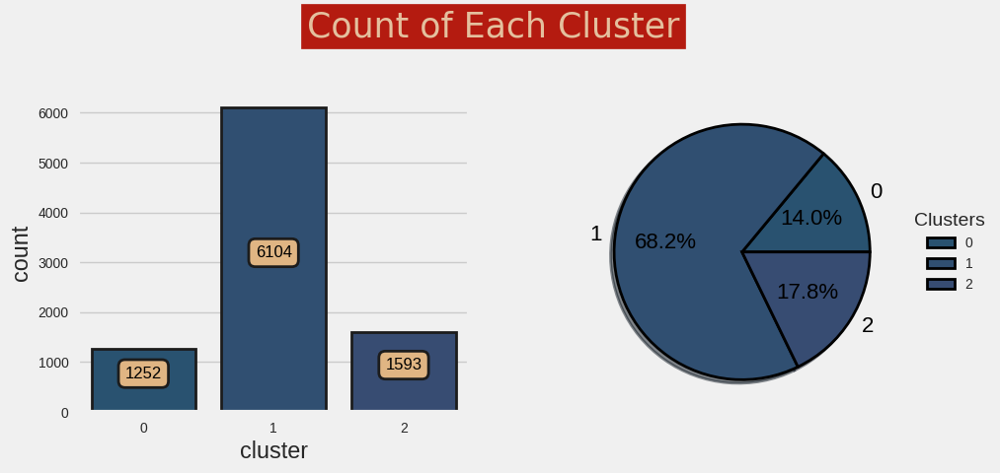

In [ ]:
check_result(df_result_kmeans)

**Mini Batch K-means**                 
Mini Batch K-Means clustering is a variation of the K-Means clustering algorithm that can handle large datasets more efficiently. Instead of processing the entire dataset in each iteration, it randomly selects a small subset of data points, called a mini-batch, and updates the cluster centroids based on the mini-batch. This reduces the computational time and memory usage of the algorithm, but may result in lower cluster quality. Mini Batch K-Means clustering is useful for scenarios where the data is too large to fit in memory or the speed of convergence is more important than the accuracy of the clusters.

In [ ]:
# Finding the inertia / List for K clusters

inertias = []

for k in range(1,11):
    mbkmeans = MiniBatchKMeans(n_clusters=k, random_state=42)
    mbkmeans.fit(df2)
    inertias.append(mbkmeans.inertia_)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: 

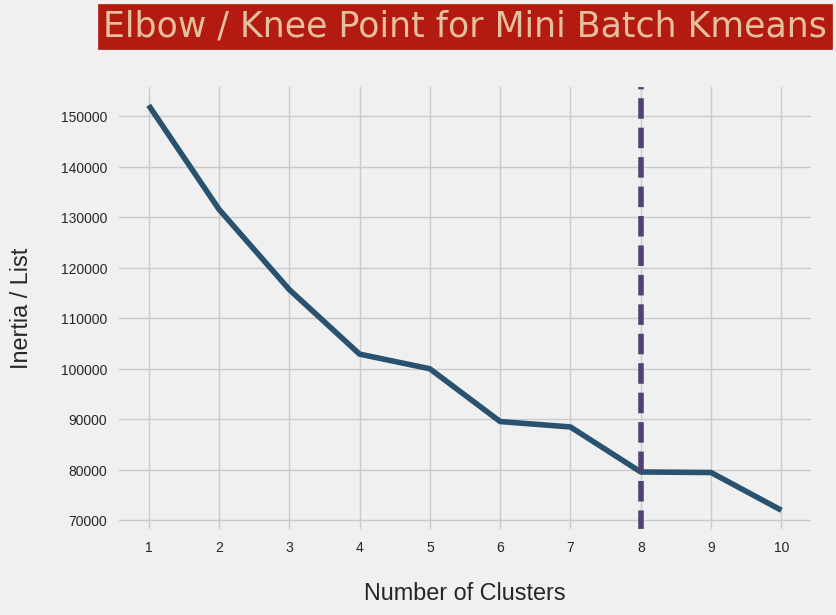

In [ ]:
elbow_optimizer(inertias, 'Mini Batch Kmeans')

According to the elbow method, the optimal number of clusters for the Mini Batch Kmeans algorithm is determined to be 8.

In [ ]:
silhouette_coef = []

for k in range(2,11):
    mbkmeans = MiniBatchKMeans(n_clusters=k, random_state=42)
    mbkmeans.fit(df2)
    score = silhouette_score(df2, mbkmeans.labels_)
    silhouette_coef.append(score)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: 

In [ ]:
calinski_harabasz_coef = []

for k in range(2,11):
    mbkmeans = MiniBatchKMeans(n_clusters=k, random_state=42)
    mbkmeans.fit(df2)
    score = calinski_harabasz_score(df2, mbkmeans.labels_)
    calinski_harabasz_coef.append(score)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: 

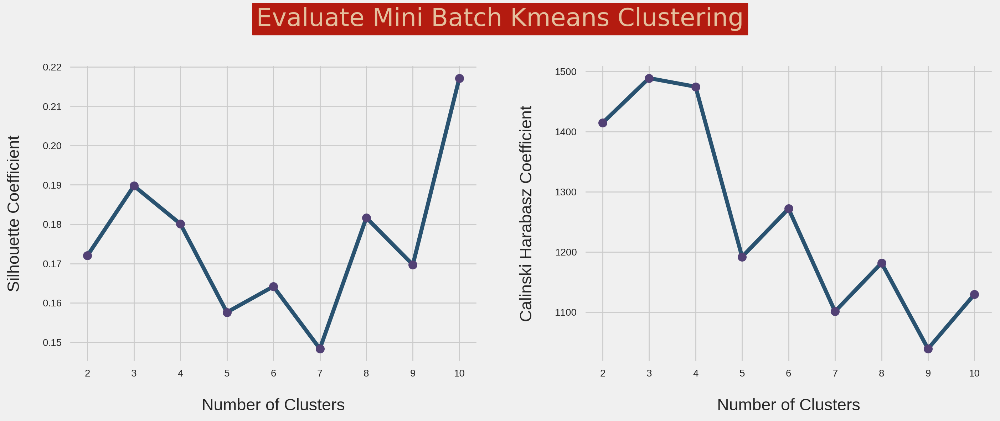

In [ ]:
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'Mini Batch Kmeans')

The results obtained previously differ from those derived through the elbow method.              
Additionally, the displayed graphs present varying outcomes, posing a challenge in determining the optimal k.                
Taking into account that k=3 aligns with Calinski's perspective, and the marginal difference in Silhouette evaluation between k=3 and k=10 is inconsequential, we designate k=3 as the most optimal value.        

Execute the Mini Batch Kmeans algorithm:

In [ ]:
mbkmeans = MiniBatchKMeans(n_clusters=3, random_state=42).fit(df2)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
pred = mbkmeans.labels_

In [ ]:
centroids = mbkmeans.cluster_centers_
centroids = pd.DataFrame(data=centroids, columns = [df2.columns])
centroids.T

,0,1,2
BALANCE,-0.389186,0.692168,1.609362
BALANCE_FREQUENCY,-0.166266,0.314339,0.492535
PURCHASES,-0.019955,-0.323788,3.735777
ONEOFF_PURCHASES,-0.050634,-0.231268,4.043180
INSTALLMENTS_PURCHASES,0.045853,-0.340793,1.404818
CASH_ADVANCE,-0.381832,0.786416,-0.275143
PURCHASES_FREQUENCY,0.330480,-0.761000,1.203193
ONEOFF_PURCHASES_FREQUENCY,0.080098,-0.356837,2.249498
PURCHASES_INSTALLMENTS_FREQUENCY,0.278675,-0.642161,1.189062
CASH_ADVANCE_FREQUENCY,-0.501230,1.071292,-0.485294


In [ ]:
best_model.loc[len(best_model.index)] = [f"Mini Batch Kmeans", silhouette_score(df2, pred), calinski_harabasz_score(df2, pred), {"n_clusters":3, "random_state":42}]

In [ ]:
real_centroids = scaler.inverse_transform(centroids)
real_centroids = pd.DataFrame(data=real_centroids, columns = [df2.columns])
real_centroids.T


,0,1,2
BALANCE,754.568790,3005.373962,4914.483265
BALANCE_FREQUENCY,0.837981,0.951781,0.993975
PURCHASES,960.681952,311.508449,8985.209780
ONEOFF_PURCHASES,508.456893,208.627239,7303.680718
INSTALLMENTS_PURCHASES,452.579650,102.924882,1681.529062
CASH_ADVANCE,178.201560,2628.190377,401.944260
PURCHASES_FREQUENCY,0.623039,0.184988,0.973292
ONEOFF_PURCHASES_FREQUENCY,0.226376,0.096026,0.873569
PURCHASES_INSTALLMENTS_FREQUENCY,0.475232,0.109265,0.837046
CASH_ADVANCE_FREQUENCY,0.034834,0.349529,0.038023


In [ ]:
df_result_mbkmeans = pd.concat([df1, pd.DataFrame(pred, columns=['cluster'])], axis = 1)
df_result_mbkmeans

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,1
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,379.829982,0.000000,12.0,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8944,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,0
8945,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,156.060050,0.000000,6.0,0
8946,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,0
8947,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,0


<ipython-input-36-b259f0639748>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=data, x='cluster', ax=axes[0], palette=dark_colors[0:int(data.cluster.nunique())], saturation=1, edgecolor = "#1c1c1c", linewidth = 2)


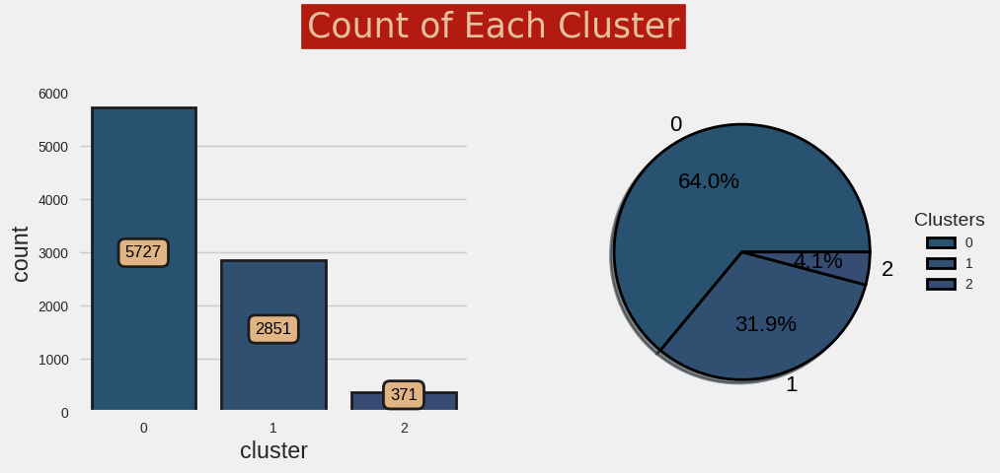

In [ ]:
check_result(df_result_mbkmeans)


**Gaussian Mixture Model (GMM)**              
A GMM is a Gaussian Mixture Model, which is a type of probabilistic model that assumes that the data is generated by a mixture of several Gaussian distributions, each with its own mean and covariance. A GMM can be used for clustering, but unlike k-means, it assigns a probability of belonging to each cluster for every data point, rather than a hard assignment. This allows for more flexibility and uncertainty in the clustering process. A GaussianMixture is a function that is comprised of several Gaussians. To implement GMMs in Python, we can use the sklearn.mixture.GaussianMixture class from the scikit-learn library. This class allows us to specify the number of components, the covariance type, and other parameters of the model. It also provides methods to fit the model to the data, predict the cluster labels, and sample new data points from the fitted distribution.

In [ ]:
set_config(display='diagram')

Determine the optimal values for n_components and covariance_type by considering the BIC score:

In [ ]:
BIC_score = []
n = []
types = []

for k in range(1,11):
    for type in ["spherical", "tied", "diag", "full"]:
        gmm = GaussianMixture(n_components=k, random_state=42, covariance_type=type)
        gmm.fit(df2)
        BIC_score.append(gmm.bic(df2))
        n.append(k)
        types.append(type)

result = pd.DataFrame()
result['n_components'] = n
result['covariance_type'] = types
result['BIC_score'] = BIC_score

In [ ]:
result.sort_values(by='BIC_score', ascending=True).head().style.background_gradient(cmap='Reds', subset='BIC_score')

,n_components,covariance_type,BIC_score
39,10,full,-349438.063089
31,8,full,-269046.133178
35,9,full,-268813.151993
27,7,full,-237792.223734
38,10,diag,-210559.095271


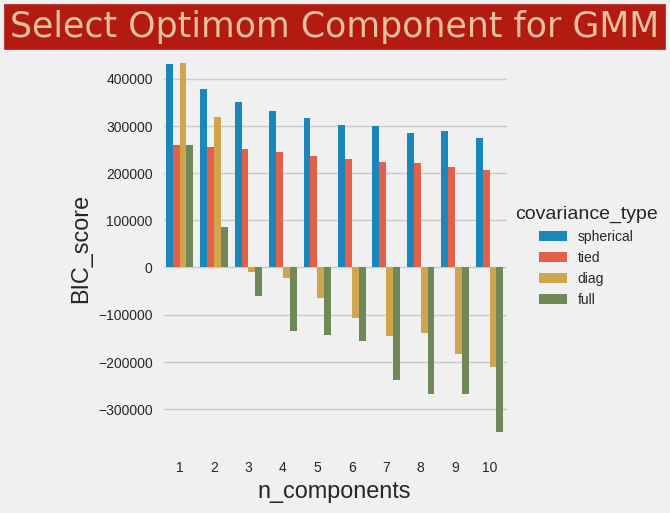

In [ ]:
sns.catplot(data=result, kind="bar", x="n_components", y="BIC_score", hue="covariance_type")

plt.title("Select Optimom Component for GMM", **FONT)
plt.show()

According to the BIC score, the optimal number of components for the GMM algorithm is determined to be n_components=10.

In [ ]:
silhouette_coef = []

for k in range(2,11):
    gmm = GaussianMixture(n_components=k, covariance_type='full', random_state=42)
    gmm.fit(df2)
    score = silhouette_score(df2, gmm.predict(df2))
    silhouette_coef.append(score)

In [ ]:
calinski_harabasz_coef = []

for k in range(2,11):
    gmm = GaussianMixture(n_components=k, covariance_type='full', random_state=42)
    gmm.fit(df2)
    score = calinski_harabasz_score(df2, gmm.predict(df2))
    calinski_harabasz_coef.append(score)

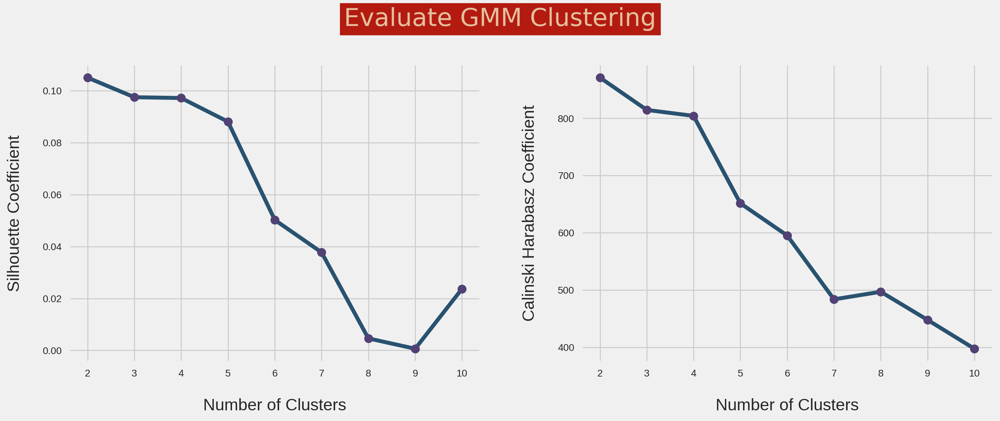

In [ ]:
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'GMM')

It appears that the BIC score method for determining the optimal value of n_components for this dataset is not yielding accurate results.              
In contrast to the BIC score, the evaluations above indicate that the optimal n_components is 2.                   
Consequently, we re-implement the GMM algorithm, this time setting n_components to 2.             

Execute the Gaussian Mixture algorithm:

In [ ]:
gmm = GaussianMixture(n_components=2, random_state=42, covariance_type='full')
gmm.fit(df2)


GaussianMixture(n_components=2, random_state=42)

In [ ]:
pred = gmm.predict(df2)

In [ ]:
cluster_means = gmm.means_
cluster_means = pd.DataFrame(data=cluster_means, columns = [df2.columns])
cluster_means.T

,0,1
BALANCE,-0.489891,0.424555
BALANCE_FREQUENCY,-0.223701,0.193866
PURCHASES,-0.003829,0.003318
ONEOFF_PURCHASES,-0.025803,0.022361
INSTALLMENTS_PURCHASES,0.038652,-0.033497
CASH_ADVANCE,-0.466758,0.404507
PURCHASES_FREQUENCY,0.400652,-0.347218
ONEOFF_PURCHASES_FREQUENCY,0.140552,-0.121806
PURCHASES_INSTALLMENTS_FREQUENCY,0.315282,-0.273233
CASH_ADVANCE_FREQUENCY,-0.674793,0.584797


In [ ]:
best_model.loc[len(best_model.index)] = [f"GMM", silhouette_score(df2, pred), calinski_harabasz_score(df2, pred), {"n_components":2, "covariance_type":'full', "random_state":42}]

In [ ]:
cluster_means = scaler.inverse_transform(cluster_means)
cluster_means = pd.DataFrame(data = cluster_means, columns = [df.columns])
cluster_means

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,544.955425,0.824381,995.135619,549.674590,446.067734,0.099313,0.651202,0.244411,0.489780,0.000100,0.001444,15.767665,4175.262332,1058.380856,261.805674,0.261225,11.602935
1,2448.345031,0.923255,1010.407124,629.620521,380.821204,1827.270871,0.351054,0.166142,0.255887,0.252171,6.063580,13.796150,4771.067088,2318.274399,1365.120601,0.060575,11.444272


In [ ]:
df_result_gmm = pd.concat([df1, pd.DataFrame(pred, columns=['cluster'])], axis = 1)
df_result_gmm

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,1
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,379.829982,0.000000,12.0,1
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8944,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,0
8945,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,156.060050,0.000000,6.0,0
8946,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,0
8947,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,1


<ipython-input-36-b259f0639748>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=data, x='cluster', ax=axes[0], palette=dark_colors[0:int(data.cluster.nunique())], saturation=1, edgecolor = "#1c1c1c", linewidth = 2)


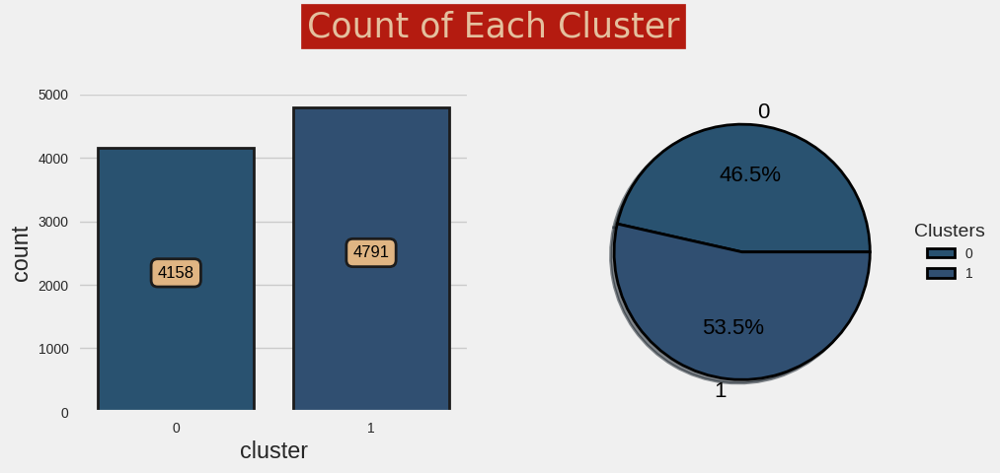

In [ ]:
check_result(df_result_gmm)

Variational Bayesian GMM:          
The Bayesian Gaussian Mixture Model object introduces a variation of the Gaussian mixture model utilizing variational inference algorithms. Its API closely resembles that defined by GaussianMixture.

In [ ]:
silhouette_coef = []

for k in range(2,11):
    bgmm = BayesianGaussianMixture(n_components=k, random_state=42)
    bgmm.fit(df2)
    score = silhouette_score(df2, bgmm.fit_predict(df2))
    silhouette_coef.append(score)

/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(


In [ ]:
calinski_harabasz_coef = []

for k in range(2,11):
    bgmm = BayesianGaussianMixture(n_components=k, random_state=42)
    bgmm.fit(df2)
    score = calinski_harabasz_score(df2, bgmm.fit_predict(df2))
    calinski_harabasz_coef.append(score)

/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(


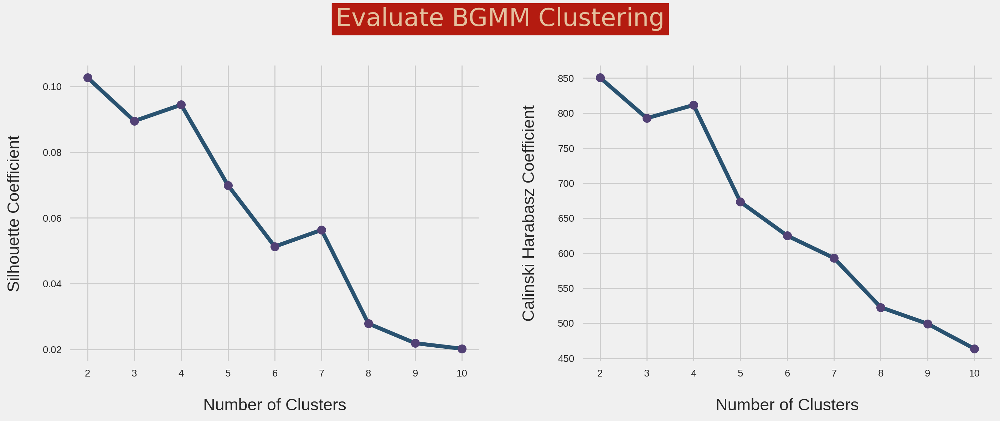

In [ ]:
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'BGMM')

It seems that the results obtained for BayesianGaussianMixture are nearly identical to those of GaussianMixture.

Execute the Bayesian Gaussian Mixture Model:

In [ ]:
bgmm = BayesianGaussianMixture(n_components=2, random_state=42)
bgmm.fit(df2)

BayesianGaussianMixture(n_components=2, random_state=42)

In [ ]:
pred = bgmm.fit_predict(df2)

In [ ]:
cluster_means = bgmm.means_
cluster_means = pd.DataFrame(data=cluster_means, columns = [df2.columns])
cluster_means.T

,0,1
BALANCE,-0.508994,0.465918
BALANCE_FREQUENCY,-0.226737,0.207549
PURCHASES,-0.069938,0.064020
ONEOFF_PURCHASES,-0.078924,0.072244
INSTALLMENTS_PURCHASES,-0.020052,0.018355
CASH_ADVANCE,-0.462996,0.423813
PURCHASES_FREQUENCY,0.314372,-0.287767
ONEOFF_PURCHASES_FREQUENCY,0.077145,-0.070616
PURCHASES_INSTALLMENTS_FREQUENCY,0.243167,-0.222588
CASH_ADVANCE_FREQUENCY,-0.644463,0.589922


In [ ]:
best_model.loc[len(best_model.index)] = [f"BGMM", silhouette_score(df2, pred), calinski_harabasz_score(df2, pred), {"n_components":2, "covariance_type":'full', "random_state":42}]

In [ ]:
cluster_means = scaler.inverse_transform(cluster_means)
cluster_means = pd.DataFrame(data = cluster_means, columns = [df.columns])
cluster_means

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,505.193950,0.823662,853.885774,461.499905,392.979883,7.988937,0.616574,0.225495,0.461120,0.006170,0.073962,13.990987,3981.495149,943.279871,246.962330,0.252190,11.611964
1,2534.440382,0.926495,1140.101838,712.420488,427.712633,1867.757695,0.374914,0.181414,0.276015,0.253197,6.155487,15.370991,4963.992772,2456.531185,1407.516103,0.063606,11.431864


In [ ]:
df_result_bgmm = pd.concat([df1, pd.DataFrame(pred, columns=['cluster'])], axis = 1)
df_result_bgmm

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,1
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,379.829982,0.000000,12.0,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8944,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,0
8945,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,156.060050,0.000000,6.0,0
8946,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,0
8947,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,1


<ipython-input-36-b259f0639748>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=data, x='cluster', ax=axes[0], palette=dark_colors[0:int(data.cluster.nunique())], saturation=1, edgecolor = "#1c1c1c", linewidth = 2)


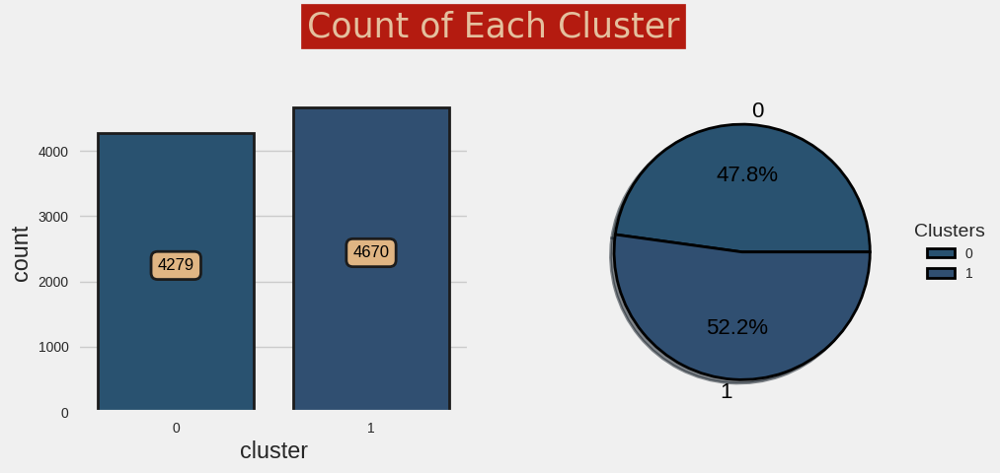

In [ ]:
check_result(df_result_bgmm)

**Mean Shift**         
Mean Shift clustering is a type of density-based clustering algorithm that does not require specifying the number of clusters in advance. It works by shifting each data point towards the nearest mode (i.e., the highest density) of the distribution of points within a certain radius. The algorithm iterates until the points converge to a local maximum of the density function. These local maxima represent the clusters in the data. Mean Shift clustering can handle arbitrary shapes and sizes of clusters, but it can be sensitive to the choice of the radius and the kernel function.

In [ ]:
bandwidth = estimate_bandwidth(df2, n_samples=10, n_jobs=-1)
bandwidth

3.034622165900537

Execute the Mean Shift algorithm with the bandwidth obtained from the estimate_bandwidth method:

In [ ]:
m_shift = MeanShift(bandwidth=bandwidth)
m_shift.fit(df2)

MeanShift(bandwidth=3.034622165900537)

In [ ]:
pred = m_shift.labels_

In [ ]:
np.unique(pred)

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176])

In [ ]:
sh_score = silhouette_score(df2, pred)
ch_score = calinski_harabasz_score(df2, pred)

In [ ]:
print(colored(f"Number of cluster: {np.unique(pred)}",'red'))
print(colored(f"Silhouette Coefficient: {sh_score}", 'red'))
print(colored(f"Calinski Harabasz Coefficient: {ch_score}", 'red'))

Number of cluster: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176]
Silhouette Coefficient: 0.12921600290892973
Calinski Harabasz Coefficient: 48.975491669383665


The predicted number of clusters is excessively large and doesn't meet our requirements.          
Moreover, the Silhouette and Calinski evaluations are unsatisfactory.       
Therefore, we opt to manually select the bandwidth.

In [ ]:
silhouette_coef = []

for k in range(10,16,2):
    m_shift = MeanShift(bandwidth=k)
    m_shift.fit(df2)
    score = silhouette_score(df2, m_shift.labels_)
    silhouette_coef.append(score)

In [ ]:
calinski_harabasz_coef = []

for k in range(10,16,2):
    m_shift = MeanShift(bandwidth=k)
    m_shift.fit(df2)
    score = calinski_harabasz_score(df2, m_shift.labels_)
    calinski_harabasz_coef.append(score)

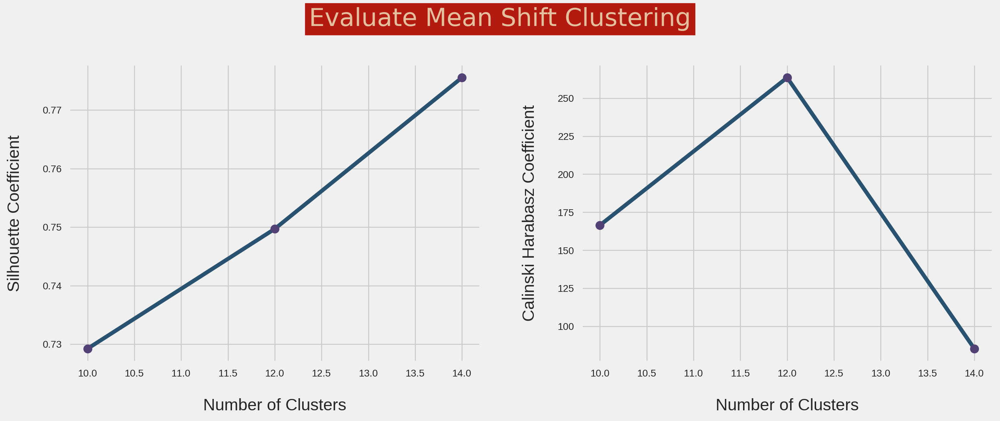

In [ ]:
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'Mean Shift', x=range(10,16,2))

Based on the results obtained above, the optimal value for bandwidth is determined to be 12.         
Consequently, we re-implement Mean Shift with the specified bandwidth of 12.

Execute the Mean Shift algorithm with the bandwidth set to 12:

In [ ]:
m_shift = MeanShift(bandwidth=12)
m_shift.fit(df2)

MeanShift(bandwidth=12)

In [ ]:
pred = m_shift.labels_

In [ ]:
np.unique(pred)

array([0, 1, 2, 3, 4])

In [ ]:
print(colored(f"Number of cluster: {np.unique(pred)}",'red'))

Number of cluster: [0 1 2 3 4]


In [ ]:
best_model.loc[len(best_model.index)] = [f"Mean Shift", silhouette_score(df2, pred), calinski_harabasz_score(df2, pred), {"bandwidth":12}]

In [ ]:
centroids = m_shift.cluster_centers_
centroids = pd.DataFrame(data=centroids, columns = [df2.columns])
centroids.T


,0,1,2,3,4
BALANCE,-0.018429,4.487413,4.327121,1.199184,1.175120
BALANCE_FREQUENCY,-0.002995,0.517980,0.517980,-0.633812,0.517980
PURCHASES,-0.047214,-0.267427,3.152736,10.061124,18.270728
ONEOFF_PURCHASES,-0.041079,-0.276529,-0.356957,-0.356957,14.429400
INSTALLMENTS_PURCHASES,-0.036149,-0.124605,8.103663,24.425755,16.682091
CASH_ADVANCE,-0.022285,22.010021,-0.466805,-0.466805,-0.466805
PURCHASES_FREQUENCY,-0.005033,0.231545,1.269742,0.023907,1.269742
ONEOFF_PURCHASES_FREQUENCY,-0.008665,0.159287,-0.678716,-0.678716,2.673295
PURCHASES_INSTALLMENTS_FREQUENCY,-0.005388,0.340997,1.599083,0.131316,1.599083
CASH_ADVANCE_FREQUENCY,-0.005644,4.321680,-0.675294,-0.675294,-0.675294


In [ ]:
centroids = scaler.inverse_transform(centroids)
centroids = pd.DataFrame(data = centroids, columns = [df2.columns])
centroids

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,1526.287535,0.876641,902.438368,524.318236,378.42309,932.224417,0.488385,0.199895,0.362337,0.134011,3.118967,13.966283,4422.714043,1587.027855,780.776703,0.152497,11.514885
1,10905.053810,1.000000,431.930000,133.500000,298.43000,47137.211760,0.583333,0.250000,0.500000,1.000000,123.000000,21.000000,19600.000000,39048.597620,5394.173671,0.000000,12.000000
2,10571.411070,1.000000,7739.480000,0.000000,7739.48000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,44.000000,8000.000000,2688.447014,76406.207520,0.000000,12.000000
3,4060.710208,0.727273,22500.000000,0.000000,22500.00000,0.000000,0.500000,0.000000,0.416667,0.000000,0.000000,12.000000,23000.000000,8760.860264,1645.535202,0.000000,12.000000
4,4010.621974,1.000000,40040.710000,24543.520000,15497.19000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,358.000000,18000.000000,33994.727850,703.503256,1.000000,12.000000


In [ ]:
df_result_mshift = pd.concat([df1, pd.DataFrame({'cluster': pred})], axis = 1)
df_result_mshift

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,379.829982,0.000000,12.0,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8944,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,0
8945,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,156.060050,0.000000,6.0,0
8946,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,0
8947,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,0


<ipython-input-36-b259f0639748>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=data, x='cluster', ax=axes[0], palette=dark_colors[0:int(data.cluster.nunique())], saturation=1, edgecolor = "#1c1c1c", linewidth = 2)


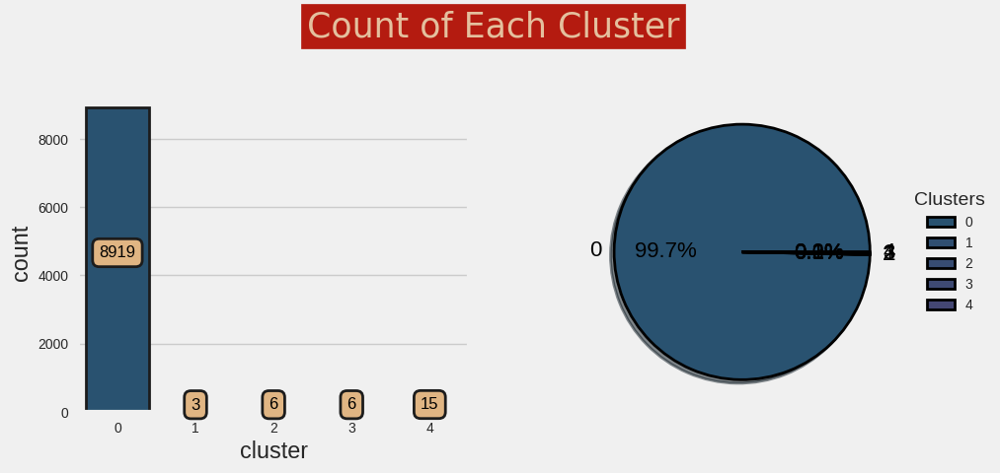

In [ ]:
check_result(df_result_mshift)

**Affinity Propagation**         
Affinity Propagation is a clustering algorithm that does not require specifying the number of clusters in advance. It works by sending messages between data points that indicate how similar they are and how likely they are to be chosen as exemplars, or representatives of clusters. The algorithm iterates until it finds a set of exemplars that best summarize the data. Affinity Propagation can handle complex and noisy data, but it can be computationally expensive and sensitive to the choice of parameters.

Execute the Affinity Propagation algorithm:

In [ ]:
affinity = AffinityPropagation(random_state=42)
affinity.fit(df2)
pred = affinity.labels_
len(np.unique(pred))

374

In [ ]:
print(colored(f"Silhouette Coefficient: {silhouette_score(df2, pred):.2f}", 'red'))
print(colored(f"Calinski Harabasz Coefficient: {calinski_harabasz_score(df2, pred):.2f}", 'red'))

Silhouette Coefficient: 0.12
Calinski Harabasz Coefficient: 232.27


In [ ]:
best_model.loc[len(best_model.index)] = [f"Affinity Propagation", silhouette_score(df2, pred), calinski_harabasz_score(df2, pred), {"random_state":42}]

The results obtained confirm our expectations that this algorithm is not suitable for clustering the desired dataset, and it is excessively time-consuming.

**Balanced Iterative Reducing and Clustering using Hierarchies (BIRCH)**        
Balanced Iterative Reducing and Clustering using Hierarchies (BIRCH) is a clustering algorithm that can handle large datasets by creating a compact summary of the data, called a CF tree, that preserves as much information as possible. The CF tree consists of sub-clusters, each represented by a clustering feature (CF) that stores the number, linear sum, and squared sum of the data points in the sub-cluster. BIRCH assigns each data point to the closest sub-cluster and updates the CF tree accordingly. BIRCH can also be used to accelerate other clustering methods, such as k-means or Gaussian mixture models, by applying them to the sub-clusters instead of the original data.

In [ ]:
BP = Birch(threshold=0.0001)

Elbow Method to determine the number of clusters to be formed:


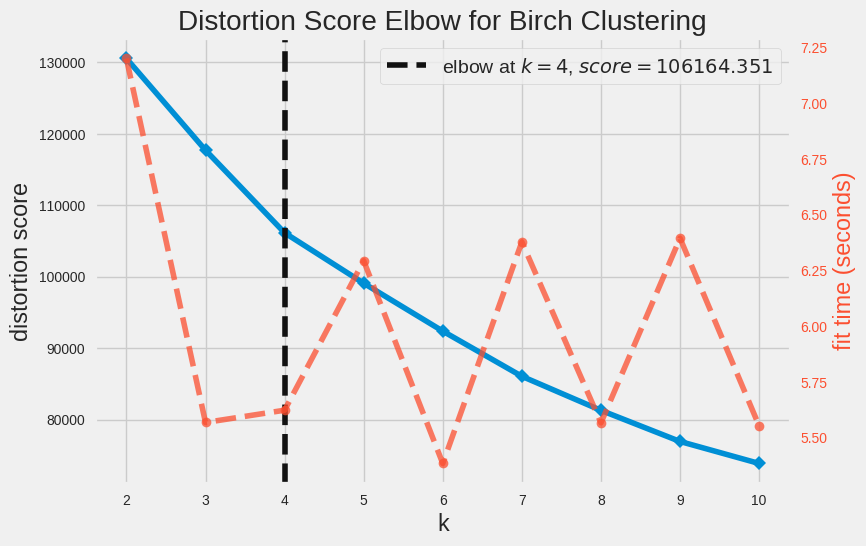

<Axes: title={'center': 'Distortion Score Elbow for Birch Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
print('Elbow Method to determine the number of clusters to be formed:')
Elbow_M = KElbowVisualizer(BP, k=10)
Elbow_M.fit(df2)
Elbow_M.show()

According to the elbow method, the optimal value for K is determined to be 4.
Now, we validate this result using Silhouette and Calinski evaluation techniques.

In [ ]:
silhouette_coef = []

for k in range(2,11):
    birch = Birch(n_clusters=k, threshold=0.0001)
    birch.fit(df2)
    score = silhouette_score(df2, birch.labels_)
    silhouette_coef.append(score)

In [ ]:
calinski_harabasz_coef = []

for k in range(2,11):
    birch = Birch(n_clusters=k, threshold=0.0001)
    birch.fit(df2)
    score = calinski_harabasz_score(df2, birch.labels_)
    calinski_harabasz_coef.append(score)

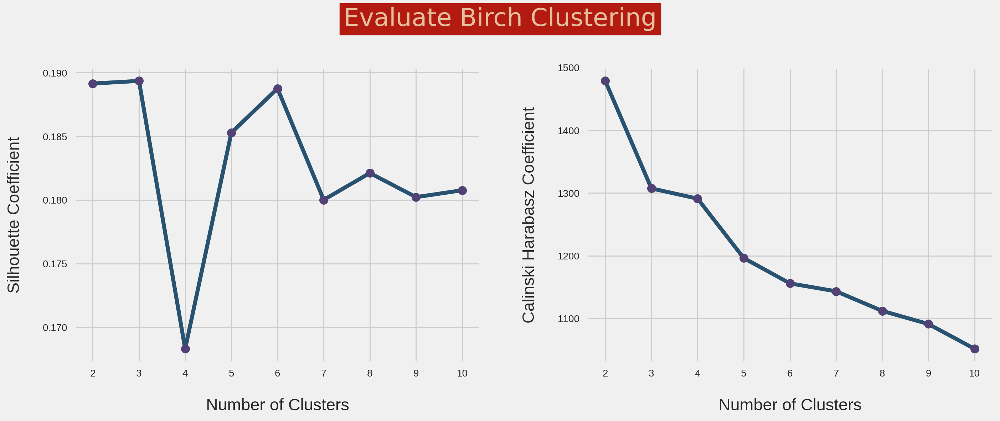

In [ ]:
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'Birch')

The results derived from the aforementioned graphs indicate that k=2 is a more suitable choice for implementing the Birch algorithm.      
Consequently, we proceed to re-implement the Birch algorithm with n_clusters=2.

Execute the Birch algorithm with the specified number of clusters (n_clusters=2):

In [ ]:
birch = Birch(n_clusters=2, threshold=0.0001)
birch.fit(df2)

Birch(n_clusters=2, threshold=0.0001)

In [ ]:
pred = birch.labels_

In [ ]:
best_model.loc[len(best_model.index)] = [f"BIRCH", silhouette_score(df2, pred), calinski_harabasz_score(df2, pred), {"n_clusters":2, "threshold":0.0001}]

In [ ]:
df_result_birch = pd.concat([df1, pd.DataFrame(pred, columns=['cluster'])], axis = 1)
df_result_birch

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,1
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,379.829982,0.000000,12.0,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8944,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,0
8945,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,156.060050,0.000000,6.0,0
8946,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,0
8947,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,0


<ipython-input-36-b259f0639748>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=data, x='cluster', ax=axes[0], palette=dark_colors[0:int(data.cluster.nunique())], saturation=1, edgecolor = "#1c1c1c", linewidth = 2)


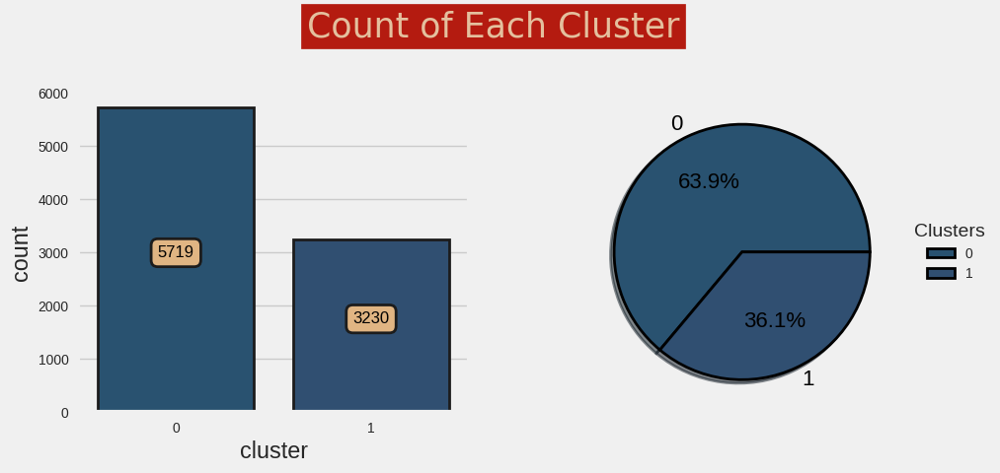

In [ ]:
check_result(df_result_birch)

**Density-Based Spatial Clustering of Applications with Noise (DBSCAN)**     
DBSCAN clustering is a density-based clustering algorithm that groups data points based on their proximity and density. It identifies clusters of high-density regions and marks outliers that lie in low-density regions. DBSCAN does not require specifying the number of clusters in advance, and can handle arbitrary shapes and sizes of clusters. However, it can be sensitive to the choice of the radius and the metric parameters.

DBSCAN works by defining two concepts: core points and reachability. A core point is a point that has at least minPts points within a radius of ε from it, where minPts and ε are hyperparameters. A point is reachable from another point if it is within ε distance from a core point. A point that is not reachable from any other point is an outlier. DBSCAN starts with an arbitrary core point and finds all points that are reachable from it. This forms a cluster. Then it repeats the process with another core point that has not been visited yet. This continues until all core points have been assigned to a cluster.

DBSCAN has several advantages over other clustering algorithms, such as k-means or Gaussian mixture models. It can discover clusters of different shapes and sizes, without assuming any prior knowledge of the number or structure of the clusters. It can also detect outliers and noise in the data, which can be useful for anomaly detection. However, DBSCAN also has some limitations. It can be difficult to choose the optimal values of minPts and ε, which can affect the quality and number of the clusters. It can also be sensitive to the choice of the distance metric, which can affect the notion of density and proximity. Moreover, it can have trouble with data that has varying densities, where a global value of ε may not be suitable for all regions.

In [ ]:
knn = NearestNeighbors(n_neighbors = 4)
model = knn.fit(df2)

In [ ]:
distances, indices = knn.kneighbors(df2)
distances = np.sort(distances, axis=0)
distances = distances[:,1]

Text(0.5, 1.0, 'K-Distance Graph')

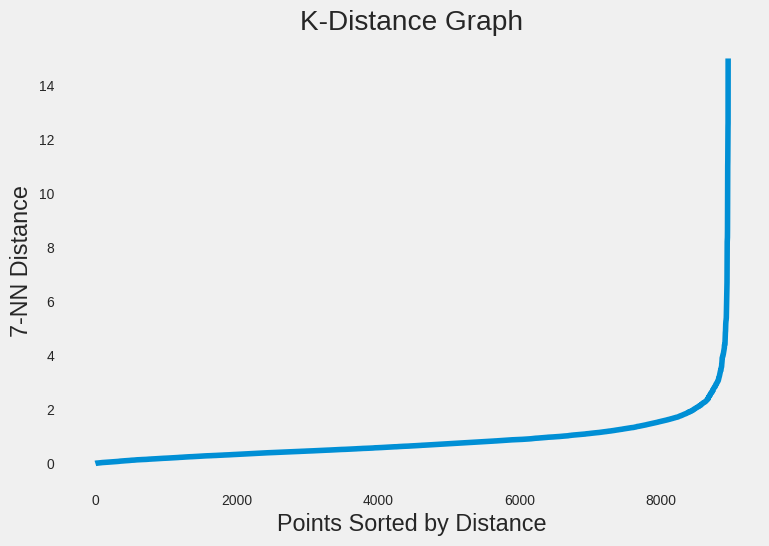

In [ ]:
plt.grid()
plt.plot(distances);
plt.xlabel('Points Sorted by Distance')
plt.ylabel('7-NN Distance')
plt.title('K-Distance Graph')

In [ ]:
eps_values = np.arange(1,15,2)

In [ ]:
min_samples = np.arange(20,41,10)

In [ ]:
DBSCAN_params = list(product(eps_values, min_samples))

In [ ]:
silhouette_coef = []
num_of_clusters = []

for param in DBSCAN_params:
    dbscan = DBSCAN(eps=param[0], min_samples=param[1])
    dbscan.fit(df2)
    score = silhouette_score(df2, dbscan.labels_)
    silhouette_coef.append(score)
    # Checking for the number of clusters
    num_of_clusters.append(len(np.unique(dbscan.labels_)))

In [ ]:
calinski_harabasz_coef = []

for param in DBSCAN_params:
    dbscan = DBSCAN(eps=param[0], min_samples=param[1])
    dbscan.fit(df2)
    score = calinski_harabasz_score(df2, dbscan.labels_)
    calinski_harabasz_coef.append(score)

In [ ]:
tmp = pd.DataFrame.from_records(DBSCAN_params, columns =['Eps', 'Min_samples'])
tmp['No_of_clusters'] = num_of_clusters

In [ ]:
pivot_1 = pd.pivot_table(tmp, values='No_of_clusters', index='Min_samples', columns='Eps')

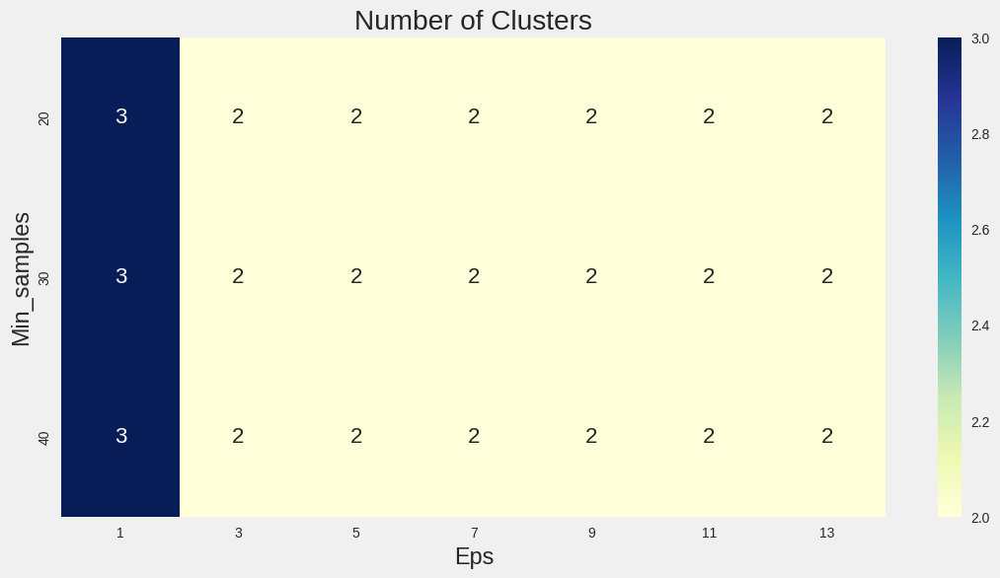

In [ ]:
fig, ax = plt.subplots(figsize=(12,6))

sns.heatmap(pivot_1, annot=True,annot_kws={"size": 16}, cmap="YlGnBu", ax=ax)

ax.set_title('Number of Clusters')
plt.show()

Evaluate Silhouette scores using a heatmap:

In [ ]:
tmp = pd.DataFrame.from_records(DBSCAN_params, columns =['Eps', 'Min_samples'])
tmp['Sil_score'] = silhouette_coef

In [ ]:
pivot_1 = pd.pivot_table(tmp, values='Sil_score', index='Min_samples', columns='Eps')

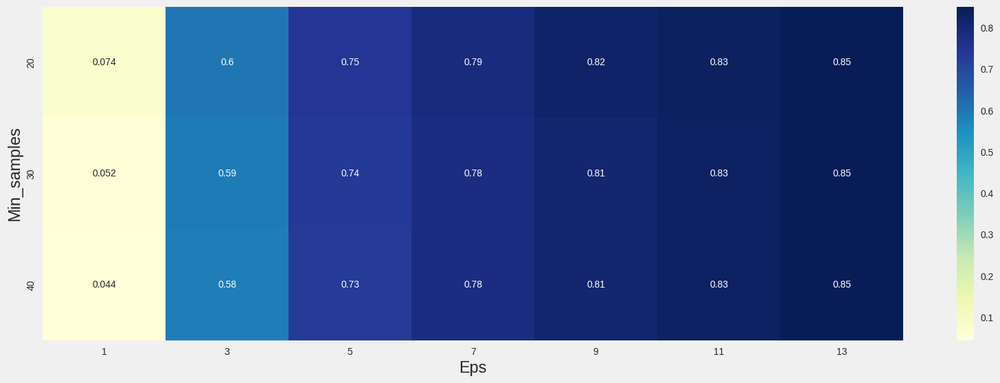

In [ ]:
fig, ax = plt.subplots(figsize=(18,6))

sns.heatmap(pivot_1, annot=True, annot_kws={"size": 10}, cmap="YlGnBu", ax=ax)

plt.show()

Evaluate Calinski scores using a Heatmap:

In [ ]:
tmp = pd.DataFrame.from_records(DBSCAN_params, columns =['Eps', 'Min_samples'])
tmp['CH_score'] = calinski_harabasz_coef

In [ ]:
pivot_1 = pd.pivot_table(tmp, values='CH_score', index='Min_samples', columns='Eps')

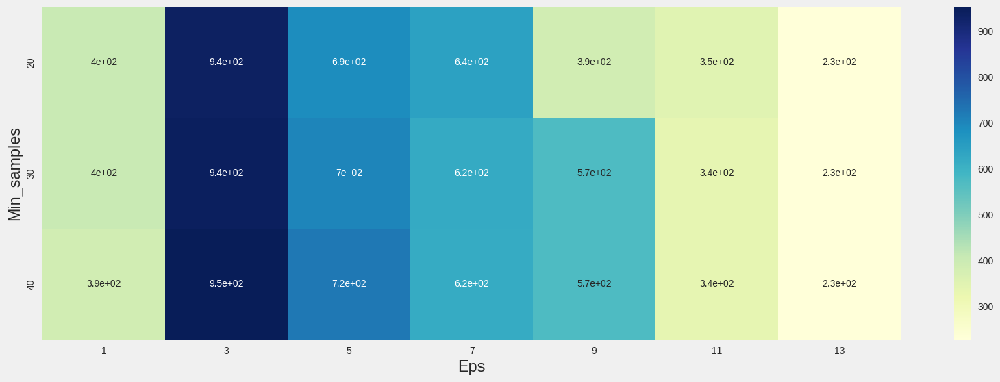

In [ ]:
fig, ax = plt.subplots(figsize=(18,6))

sns.heatmap(pivot_1, annot=True, annot_kws={"size": 10}, cmap="YlGnBu", ax=ax)

plt.show()

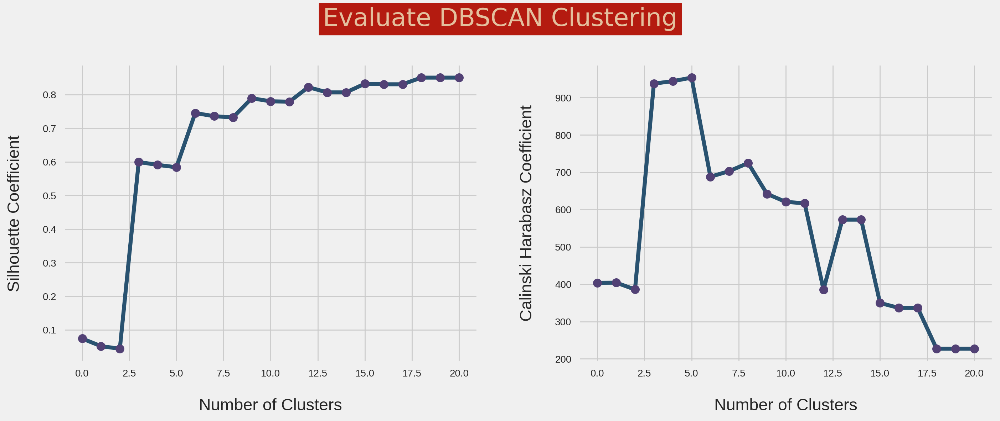

In [ ]:
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'DBSCAN', x=range(len(DBSCAN_params)))

Specify the coordinates of points in the above table for DBSCAN:

In [ ]:
for i in enumerate(DBSCAN_params):
    print(i)

(0, (1, 20))
(1, (1, 30))
(2, (1, 40))
(3, (3, 20))
(4, (3, 30))
(5, (3, 40))
(6, (5, 20))
(7, (5, 30))
(8, (5, 40))
(9, (7, 20))
(10, (7, 30))
(11, (7, 40))
(12, (9, 20))
(13, (9, 30))
(14, (9, 40))
(15, (11, 20))
(16, (11, 30))
(17, (11, 40))
(18, (13, 20))
(19, (13, 30))
(20, (13, 40))


Based on the above results, as eps increases, the Silhouette coefficient approaches 1, indicating better clustering.         
However, according to the Calinski coefficient, eps decreases.       
Therefore, considering the K-distance diagram, the optimal value for eps lies between 3 and 5.          
Next, we will explore eps values between 3 and 5.      

In [ ]:
eps_values = np.arange(3,5,0.25)

In [ ]:
min_samples = np.arange(20,41,10)

In [ ]:
DBSCAN_params = list(product(eps_values, min_samples))

In [ ]:
silhouette_coef = []
num_of_clusters = []

for param in DBSCAN_params:
    dbscan = DBSCAN(eps=param[0], min_samples=param[1])
    dbscan.fit(df2)
    score = silhouette_score(df2, dbscan.labels_)
    silhouette_coef.append(score)
    # for check number of clusters
    num_of_clusters.append(len(np.unique(dbscan.labels_)))

In [ ]:
calinski_harabasz_coef = []

for param in DBSCAN_params:
    dbscan = DBSCAN(eps=param[0], min_samples=param[1])
    dbscan.fit(df2)
    score = calinski_harabasz_score(df2, dbscan.labels_)
    calinski_harabasz_coef.append(score)

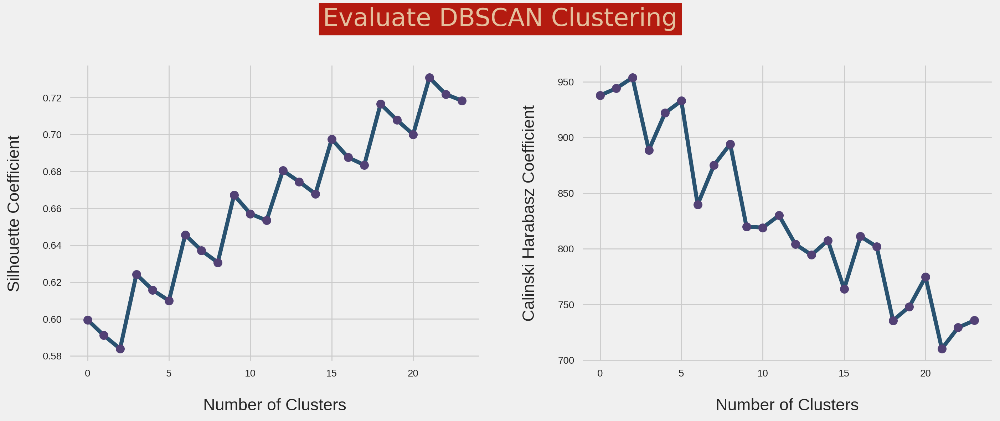

In [ ]:
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'DBSCAN', x=range(len(DBSCAN_params)))

In [ ]:
for i in enumerate(DBSCAN_params):
    print(i)

(0, (3.0, 20))
(1, (3.0, 30))
(2, (3.0, 40))
(3, (3.25, 20))
(4, (3.25, 30))
(5, (3.25, 40))
(6, (3.5, 20))
(7, (3.5, 30))
(8, (3.5, 40))
(9, (3.75, 20))
(10, (3.75, 30))
(11, (3.75, 40))
(12, (4.0, 20))
(13, (4.0, 30))
(14, (4.0, 40))
(15, (4.25, 20))
(16, (4.25, 30))
(17, (4.25, 40))
(18, (4.5, 20))
(19, (4.5, 30))
(20, (4.5, 40))
(21, (4.75, 20))
(22, (4.75, 30))
(23, (4.75, 40))


Based on the results obtained above, we select eps=3.5 and min_samples=40 and proceed to implement the DBSCAN algorithm.

Execute the DBSCAN algorithm with the optimal values for eps=3.5 and min_samples=40 obtained from the previous evaluation:

In [ ]:
dbscan = DBSCAN(eps=3.5, min_samples=40)
dbscan.fit(df2)

DBSCAN(eps=3.5, min_samples=40)

In [ ]:
pred = dbscan.labels_

In [ ]:
num_of_clusters = len(np.unique(pred))

In [ ]:
sh_score = silhouette_score(df2, pred)
ch_score = calinski_harabasz_score(df2, pred)

In [ ]:
print(colored(f"Number of cluster: {np.unique(pred)}",'red'))
print(colored(f"Silhouette Coefficient: {sh_score:.2f}", 'red'))
print(colored(f"Calinski Harabasz Coefficient: {ch_score:.2f}", 'red'))

Number of cluster: [-1  0]
Silhouette Coefficient: 0.63
Calinski Harabasz Coefficient: 894.06


In [ ]:
best_model.loc[len(best_model.index)] = [f"DBSCAN", silhouette_score(df2, pred), calinski_harabasz_score(df2, pred), {"eps":3.5, "min_samples":40}]

In [ ]:
df_result_dbscan = pd.concat([df1, pd.DataFrame(pred, columns=['cluster'])], axis = 1)
df_result_dbscan

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,379.829982,0.000000,12.0,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8944,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,0
8945,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,156.060050,0.000000,6.0,0
8946,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,0
8947,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,0


<ipython-input-36-b259f0639748>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=data, x='cluster', ax=axes[0], palette=dark_colors[0:int(data.cluster.nunique())], saturation=1, edgecolor = "#1c1c1c", linewidth = 2)


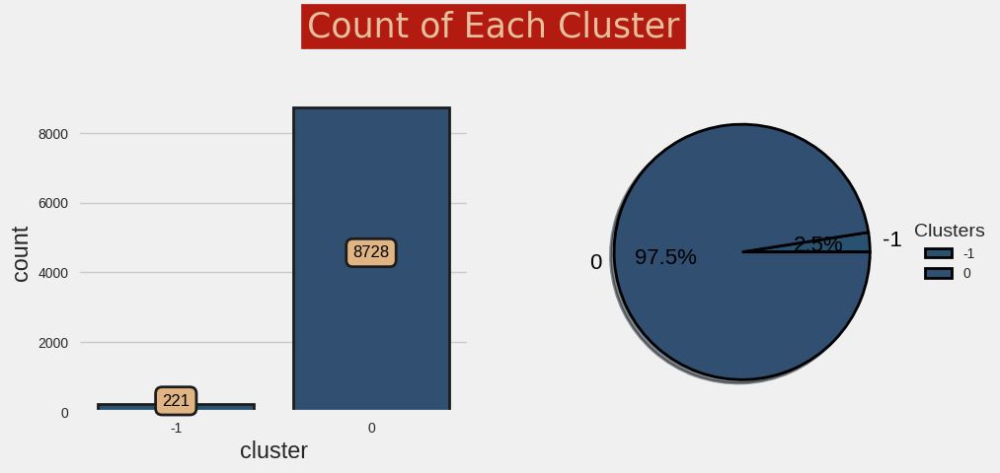

In [ ]:
check_result(df_result_dbscan)

**Hierarchical Clustering**             
Hierarchical clustering is a method of cluster analysis that seeks to build a hierarchy of clusters based on the similarity or dissimilarity of data points. It can be either agglomerative, which merges smaller clusters into larger ones, or divisive, which splits larger clusters into smaller ones. The result of hierarchical clustering can be visualized as a tree-like structure called a dendrogram.

Create a dendrogram for Agglomerative clustering:

In [ ]:
def dendoOptimizer(data):
    sch.dendrogram(sch.linkage(data, method='ward'))
    plt.title('Dendrogram')
    plt.xlabel('Customers')
    plt.ylabel('Euclidean distances')
    plt.show()

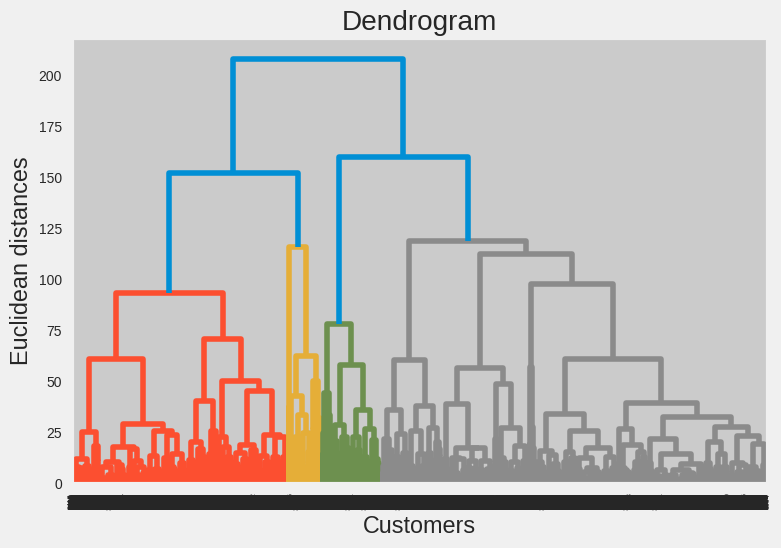

In [ ]:
dendoOptimizer(df2)

In [ ]:
silhouette_coef = []

for k in range(2,15):
    agg = AgglomerativeClustering(n_clusters=k)
    agg.fit(df2)
    score = silhouette_score(df2, agg.fit_predict(df2))
    silhouette_coef.append(score)

In [ ]:
calinski_harabasz_coef = []

for k in range(2,15):
    agg = AgglomerativeClustering(n_clusters=k)
    agg.fit(df2)
    score = calinski_harabasz_score(df2, agg.fit_predict(df2))
    calinski_harabasz_coef.append(score)

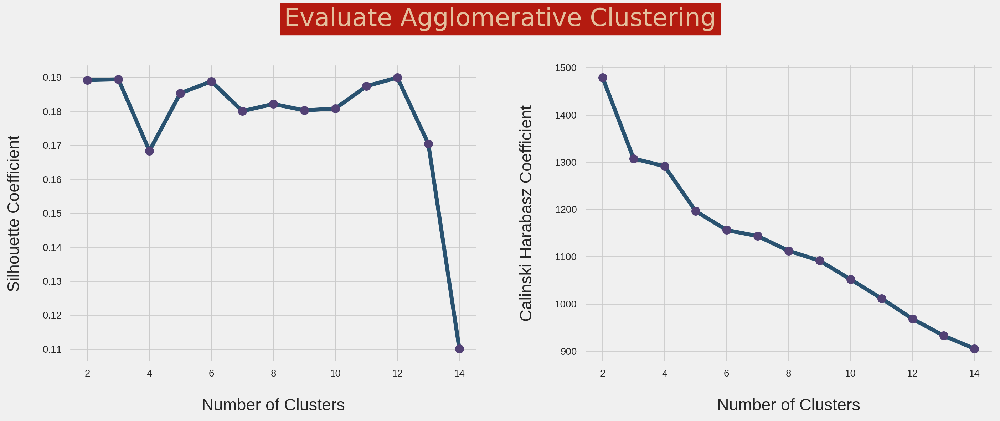

In [ ]:
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'Agglomerative', x=range(2,15))

Based on the diagrams above, n_clusters=2 appears to be appropriate.      
Therefore, we proceed to implement the Agglomerative algorithm with n_clusters=2.       
Execute the Agglomerative Clustering algorithm with the specified number of clusters (n_clusters=2):

In [ ]:
agg = AgglomerativeClustering(n_clusters=2)
agg.fit(df2)

AgglomerativeClustering()

In [ ]:
pred = agg.labels_

In [ ]:
sh_score = silhouette_score(df2, pred)
ch_score = calinski_harabasz_score(df2, pred)

In [ ]:
print(colored(f"Silhouette Coefficient: {sh_score:.2f}", 'red'))
print(colored(f"Calinski Harabasz Coefficient: {ch_score:.2f}", 'red'))

Silhouette Coefficient: 0.19
Calinski Harabasz Coefficient: 1478.76


In [ ]:
df_result_agg = pd.concat([df1, pd.DataFrame(pred, columns=['cluster'])], axis = 1)
df_result_agg

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,1
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,379.829982,0.000000,12.0,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8944,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,0
8945,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,156.060050,0.000000,6.0,0
8946,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,0
8947,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,0


In [ ]:
best_model.loc[len(best_model.index)] = [f"Agglomerative", silhouette_score(df2, pred), calinski_harabasz_score(df2, pred), {"n_clusters":2}]

<ipython-input-36-b259f0639748>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=data, x='cluster', ax=axes[0], palette=dark_colors[0:int(data.cluster.nunique())], saturation=1, edgecolor = "#1c1c1c", linewidth = 2)


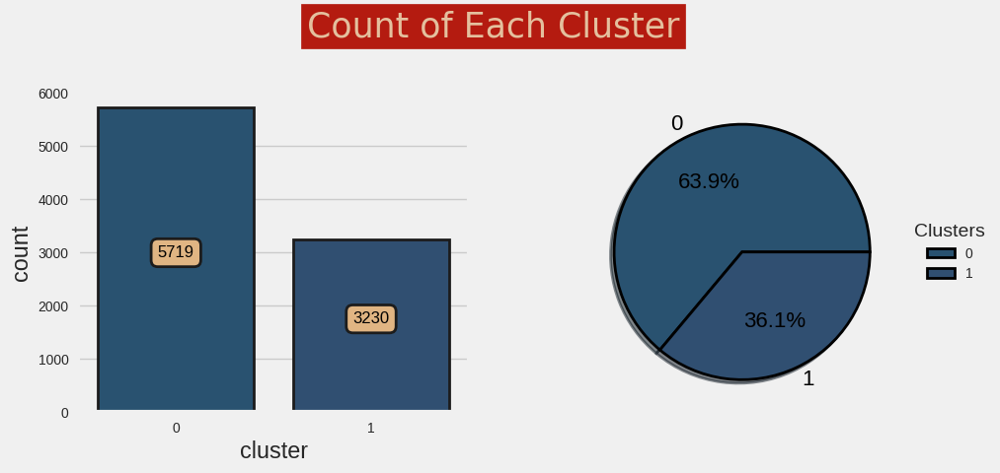

In [ ]:
check_result(df_result_agg)

**Comparing the implemented models**

In [ ]:
best_model

,Model,Sil_score,CH_score,setting
0,Kmeans,0.250241,1605.200600,"{'n_clusters': 3, 'init': 'random', 'n_init': ..."
1,Mini Batch Kmeans,0.189745,1488.925877,"{'n_clusters': 3, 'random_state': 42}"
2,GMM,0.105037,870.902819,"{'n_components': 2, 'covariance_type': 'full',..."
3,BGMM,0.102698,850.665490,"{'n_components': 2, 'covariance_type': 'full',..."
4,Mean Shift,0.749684,263.482643,{'bandwidth': 12}
5,Affinity Propagation,0.121511,232.268007,{'random_state': 42}
6,BIRCH,0.189152,1478.757090,"{'n_clusters': 2, 'threshold': 0.0001}"
7,DBSCAN,0.630633,894.056713,"{'eps': 3.5, 'min_samples': 40}"
8,Agglomerative,0.189152,1478.757090,{'n_clusters': 2}


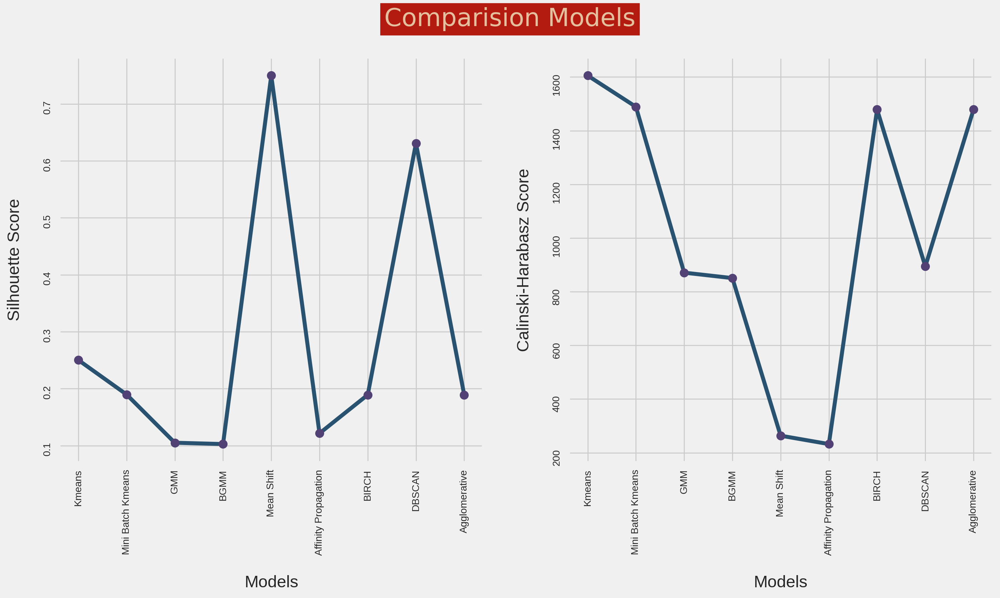

In [ ]:
fig, ax = plt.subplots(1,2,figsize=(15,7), dpi=200)

ax[0].plot(best_model.Model, best_model.Sil_score, marker='o', c=dark_colors[0], ms=9, mfc=dark_colors[-1])
ax[1].plot(best_model.Model, best_model.CH_score, marker='o', c=dark_colors[0], ms=9, mfc=dark_colors[-1])

ax[0].set_xlabel("Models", labelpad=20)
ax[0].set_ylabel("Silhouette Score", labelpad=20)

ax[1].set_xlabel("Models", labelpad=20)
ax[1].set_ylabel("Calinski-Harabasz Score", labelpad=20)

ax[0].tick_params(labelrotation=90)
ax[1].tick_params(labelrotation=90)

plt.suptitle(f'Comparision Models', **FONT)

plt.show()

As observed, Mean Shift emerges as the optimal model based on the Silhouette criterion, while KMeans takes the lead according to the Calinski-Harabazs criterion.           
Additionally, DBSCAN appears to be a favorable choice across both criteria among all the models.         
Consequently, we will thoroughly examine and analyze these three models as our recommended choices.

**Implementing dimension reduction**

**Principal component analysis (PCA)**

In [ ]:
models = best_model.iloc[[0,4,7]].reset_index(drop=True)
models

,Model,Sil_score,CH_score,setting
0,Kmeans,0.250241,1605.200600,"{'n_clusters': 3, 'init': 'random', 'n_init': ..."
1,Mean Shift,0.749684,263.482643,{'bandwidth': 12}
2,DBSCAN,0.630633,894.056713,"{'eps': 3.5, 'min_samples': 40}"


In [ ]:
models.setting[0]

{'n_clusters': 3,
 'init': 'random',
 'n_init': 10,
 'max_iter': 300,
 'random_state': 42}

In [ ]:
kmeans = KMeans(**models.setting[0])
kmeans.fit(df2)

KMeans(init='random', n_clusters=3, n_init=10, random_state=42)

In [ ]:
pred_kmeans = kmeans.labels_

In [ ]:
pca = PCA(n_components = 2)
pcs = pca.fit_transform(df2)

In [ ]:
pca_df_2 = pd.DataFrame(data = pcs, columns = ['pc1', 'pc2'])
pca_df_2.head()

,pc1,pc2
0,-1.683711,-1.072992
1,-1.135333,2.507305
2,0.969114,-0.383415
3,-0.886746,0.008196
4,-1.600178,-0.684143


In [ ]:
kmeans_pca_2d = pd.concat([pca_df_2, pd.DataFrame({'cluster':pred_kmeans})], axis=1)
kmeans_pca_2d.head()

,pc1,pc2,cluster
0,-1.683711,-1.072992,1
1,-1.135333,2.507305,2
2,0.969114,-0.383415,1
3,-0.886746,0.008196,1
4,-1.600178,-0.684143,1


Create a 2D visualization of KMeans clustering by utilizing PCA:

Text(0.5, 0.98, '2D visualization of KMeans clustering by utilizing PCA')

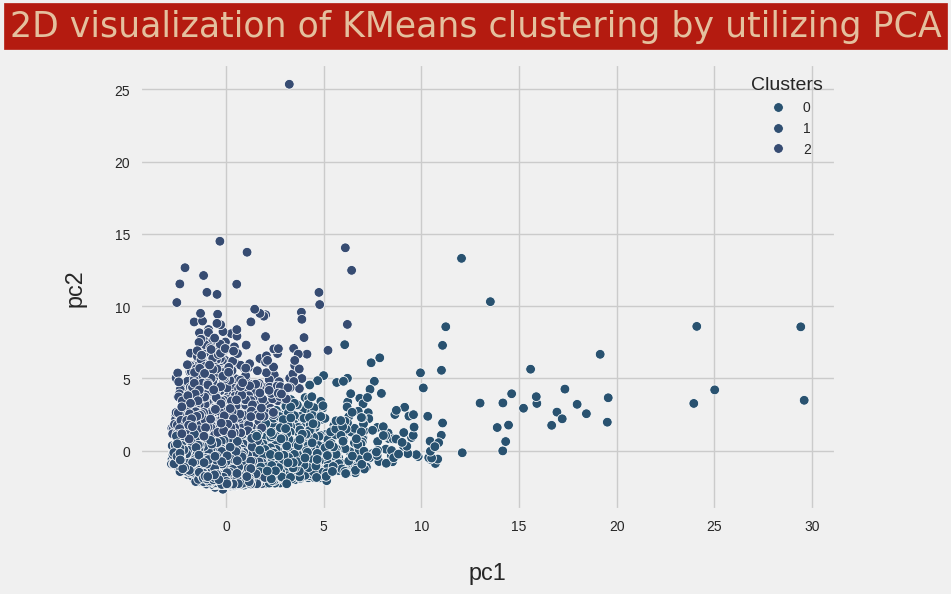

In [ ]:
sns.scatterplot(x='pc1', y='pc2', hue='cluster', data=kmeans_pca_2d, palette=dark_colors[0:3])

plt.xlabel("pc1", labelpad=20)
plt.ylabel("pc2", labelpad=20)

plt.legend(title="Clusters", edgecolor = "black")

plt.suptitle(f'2D visualization of KMeans clustering by utilizing PCA', **FONT)

Utilize PCA for KMeans clustering with a focus on 3D visualization, Train PCA and determine the three principal components for 3D visualization:

In [ ]:
pca = PCA(n_components = 3)
pcs = pca.fit_transform(df2)

In [ ]:
pca_df_3 = pd.DataFrame(data = pcs, columns = ['pc1', 'pc2', 'pc3'])
pca_df_3.head()

,pc1,pc2,pc3
0,-1.683713,-1.072991,0.471698
1,-1.135336,2.507301,0.608413
2,0.969113,-0.383406,0.084538
3,-0.886748,0.008199,1.488046
4,-1.600178,-0.684143,0.341389


In [ ]:
kmeans_pca_3d = pd.concat([pca_df_3, pd.DataFrame({'cluster':pred_kmeans})], axis=1)
kmeans_pca_3d.head()

,pc1,pc2,pc3,cluster
0,-1.683713,-1.072991,0.471698,1
1,-1.135336,2.507301,0.608413,2
2,0.969113,-0.383406,0.084538,1
3,-0.886748,0.008199,1.488046,1
4,-1.600178,-0.684143,0.341389,1


Create a 3D visualization of KMeans clustering using PCA:

In [ ]:
fig = px.scatter_3d(data_frame= kmeans_pca_3d, x='pc1', y='pc2', z='pc3', color=kmeans_pca_3d.cluster.astype('category'), color_discrete_map={0:dark_colors[0], 1:dark_colors[1], 2:dark_colors[2], 3:dark_colors[3]}, opacity=0.6, height=500, title=f'3D visualization of KMeans clustering using PCA')

fig.update_traces(marker_size=5)

pio.show(fig)

Perform Principal Component Analysis (PCA) to visualize Mean Shift clustering in two dimensions:

In [ ]:
models.setting[1]

{'bandwidth': 12}

In [ ]:
m_shift = MeanShift(**models.setting[1])
m_shift.fit(df2)

MeanShift(bandwidth=12)

In [ ]:
pred_mshift = m_shift.labels_

In [ ]:
np.unique(pred)

array([0, 1])

In [ ]:
print(colored(f"Number of cluster: {np.unique(pred)}",'red'))

Number of cluster: [0 1]


In [ ]:
mshift_result_2d = pd.concat([pca_df_2, pd.DataFrame({'cluster':pred_mshift})], axis=1)
mshift_result_2d.head()

,pc1,pc2,cluster
0,-1.683711,-1.072992,0
1,-1.135333,2.507305,0
2,0.969114,-0.383415,0
3,-0.886746,0.008196,0
4,-1.600178,-0.684143,0


Create a 2D visualization of Mean Shift clustering using PCA:

Text(0.5, 0.98, '2D visualization of Mean Shift clustering using PCA')

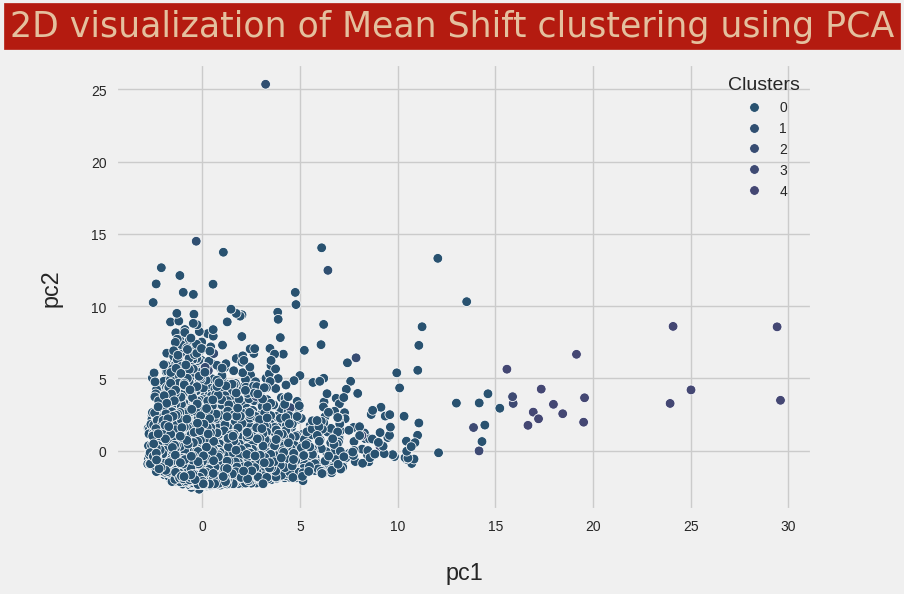

In [ ]:
sns.scatterplot(x='pc1', y='pc2', hue='cluster', data=mshift_result_2d, palette=dark_colors[0:5])

plt.xlabel("pc1", labelpad=20)
plt.ylabel("pc2", labelpad=20)

plt.legend(title="Clusters", edgecolor = "black")

plt.suptitle(f'2D visualization of Mean Shift clustering using PCA', **FONT)

In [ ]:
mshift_pca_3d = pd.concat([pca_df_3, pd.DataFrame({'cluster':pred_mshift})], axis=1)
mshift_pca_3d.head()

,pc1,pc2,pc3,cluster
0,-1.683713,-1.072991,0.471698,0
1,-1.135336,2.507301,0.608413,0
2,0.969113,-0.383406,0.084538,0
3,-0.886748,0.008199,1.488046,0
4,-1.600178,-0.684143,0.341389,0


Create a 3D visualization of Mean Shift clustering using PCA:

In [ ]:
fig = px.scatter_3d(data_frame= mshift_pca_3d, x='pc1', y='pc2', z='pc3', color=mshift_pca_3d.cluster.astype('category'), color_discrete_map={0:dark_colors[0], 1:dark_colors[1], 2:dark_colors[2], 3:dark_colors[3], 4:dark_colors[4]}, opacity=0.6, height=500, title=f'3D visualization of Mean Shift clustring by using PCA')

fig.update_traces(marker_size = 5)

pio.show(fig)

Utilize PCA for a 2D visualization of DBSCAN clustering:

In [ ]:
models.setting[2]

{'eps': 3.5, 'min_samples': 40}

In [ ]:
dbscan = DBSCAN(**models.setting[2])
dbscan.fit(df2)

DBSCAN(eps=3.5, min_samples=40)

In [ ]:
pred_dbscan = dbscan.labels_

In [ ]:
num_of_clusters = len(np.unique(pred))

In [ ]:
print(colored(f"Number of cluster: {np.unique(pred)}",'red'))

Number of cluster: [0 1]


In [ ]:
dbscan_result_2d = pd.concat([pca_df_2, pd.DataFrame({'cluster':pred_dbscan})], axis=1)
dbscan_result_2d.head()

,pc1,pc2,cluster
0,-1.683711,-1.072992,0
1,-1.135333,2.507305,0
2,0.969114,-0.383415,0
3,-0.886746,0.008196,0
4,-1.600178,-0.684143,0


Create a 2D visualization of DBSCAN clustering using PCA:

Text(0.5, 0.98, '2D visualization of DBSCAN clustring by using PCA')

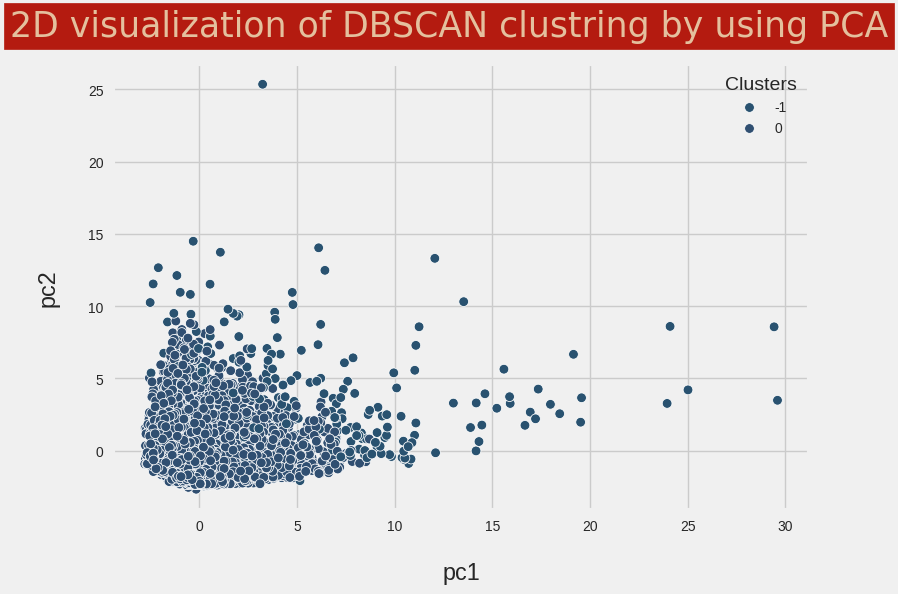

In [ ]:
sns.scatterplot(x='pc1', y='pc2', hue='cluster', data=dbscan_result_2d, palette=dark_colors[0:2])

plt.xlabel("pc1", labelpad=20)
plt.ylabel("pc2", labelpad=20)

plt.legend(title="Clusters", edgecolor = "black")

plt.suptitle(f'2D visualization of DBSCAN clustring by using PCA', **FONT)

Utilize PCA for 3D visualization of DBSCAN clustering, combine the cluster labels with the dataframe through concatenation.:

In [ ]:
dbscan_pca_3d = pd.concat([pca_df_3, pd.DataFrame({'cluster':pred_dbscan})], axis=1)
dbscan_pca_3d.head()

,pc1,pc2,pc3,cluster
0,-1.683713,-1.072991,0.471698,0
1,-1.135336,2.507301,0.608413,0
2,0.969113,-0.383406,0.084538,0
3,-0.886748,0.008199,1.488046,0
4,-1.600178,-0.684143,0.341389,0


In [ ]:
fig = px.scatter_3d(data_frame= dbscan_pca_3d, x='pc1', y='pc2', z='pc3', color=dbscan_pca_3d.cluster.astype('category'), color_discrete_map={-1:dark_colors[0], 0:dark_colors[1]}, opacity=0.6, height=500, title=f'3D visualization of DBSCAN clustering using PCA')

fig.update_traces(marker_size = 5)

pio.show(fig)

**T-distributed Stochastic Neighbor Embedding (t-SNE)**

Train the t-SNE algorithm to identify two features for 2D visualization:

In [ ]:
tsne = TSNE(n_components=2, perplexity=50, random_state=42, n_iter=300, learning_rate='auto')

In [ ]:
features = tsne.fit_transform(df2)

In [ ]:
tsne_df_2 = pd.DataFrame(data = features, columns = ['feature_1', 'feature_2'])
tsne_df_2.head()

,feature_1,feature_2
0,-3.977512,-2.326446
1,-1.555123,6.999475
2,5.197520,2.910322
3,-4.287669,-3.772099
4,-3.688967,-0.779325


For KMeans:

In [ ]:
kmeans_tsne_2d = pd.concat([tsne_df_2, pd.DataFrame({'cluster':pred_kmeans})], axis=1)
kmeans_tsne_2d.head()

,feature_1,feature_2,cluster
0,-3.977512,-2.326446,1
1,-1.555123,6.999475,2
2,5.197520,2.910322,1
3,-4.287669,-3.772099,1
4,-3.688967,-0.779325,1


Text(0.5, 0.98, '2D visualization of KMeans clustering using t-SNE')

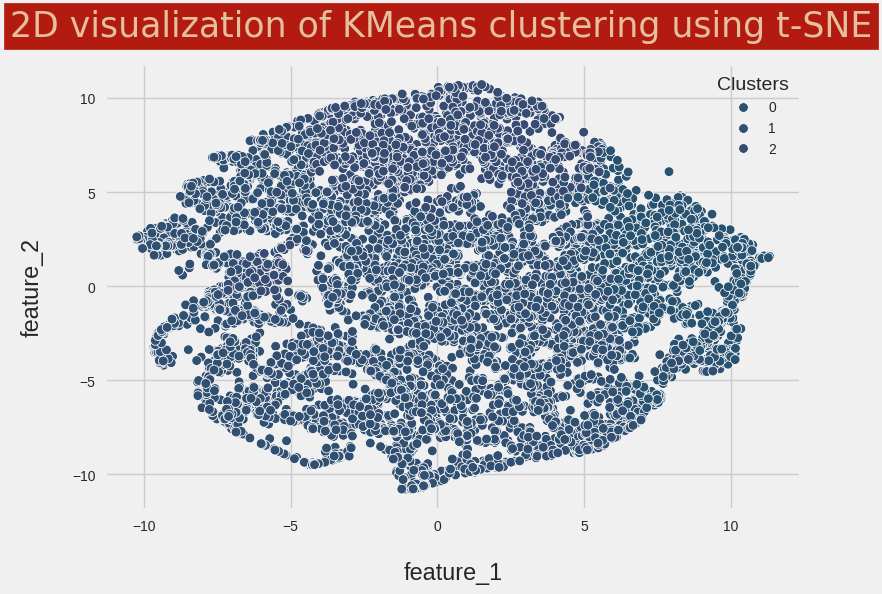

In [ ]:
sns.scatterplot(x='feature_1', y='feature_2', hue='cluster', data=kmeans_tsne_2d, palette=dark_colors[0:3])

plt.xlabel("feature_1", labelpad=20)
plt.ylabel("feature_2", labelpad=20)

plt.legend(title="Clusters", edgecolor = "black")

plt.suptitle(f'2D visualization of KMeans clustering using t-SNE', **FONT)

In [ ]:
tsne = TSNE(n_components=3, perplexity=50, random_state=42, n_iter=300, learning_rate='auto')

In [ ]:
features = tsne.fit_transform(df2)

In [ ]:
tsne_df_3 = pd.DataFrame(data = features, columns = ['feature_1', 'feature_2', 'feature_3'])
tsne_df_3.head()

,feature_1,feature_2,feature_3
0,-4.550570,-2.385834,-1.506331
1,-0.737630,2.814408,2.014997
2,2.650702,1.302480,2.116342
3,-3.009447,-1.969769,0.241896
4,-4.296540,-0.971823,-4.162506


In [ ]:
kmeans_tsne_3d = pd.concat([tsne_df_3, pd.DataFrame({'cluster':pred_kmeans})], axis=1)
kmeans_tsne_3d.head()

,feature_1,feature_2,feature_3,cluster
0,-4.550570,-2.385834,-1.506331,1
1,-0.737630,2.814408,2.014997,2
2,2.650702,1.302480,2.116342,1
3,-3.009447,-1.969769,0.241896,1
4,-4.296540,-0.971823,-4.162506,1


In [ ]:
fig = px.scatter_3d(data_frame= kmeans_tsne_3d, x='feature_1', y='feature_2', z='feature_3', color=kmeans_tsne_3d.cluster.astype('category'), color_discrete_map={0:dark_colors[0], 1:dark_colors[1], 2:dark_colors[2]}, opacity=0.6, height=500, title=f'3D visualization of KMeans clustering using t-SNE')

fig.update_traces(marker_size=5)

pio.show(fig)

For Mean Shift:

In [ ]:
mshift_tsne_2d = pd.concat([tsne_df_2, pd.DataFrame({'cluster':pred_mshift})], axis=1)
mshift_tsne_2d.head()

,feature_1,feature_2,cluster
0,-3.977512,-2.326446,0
1,-1.555123,6.999475,0
2,5.197520,2.910322,0
3,-4.287669,-3.772099,0
4,-3.688967,-0.779325,0


Text(0.5, 0.98, '2D visualization of Mean Shift clustring by using TSNE')

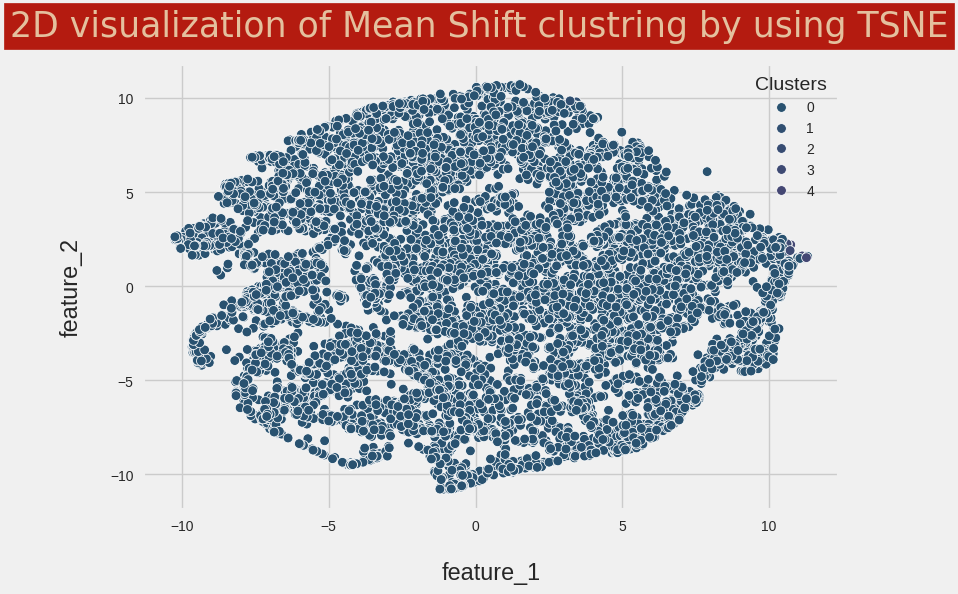

In [ ]:
sns.scatterplot(x='feature_1', y='feature_2', hue='cluster', data=mshift_tsne_2d, palette=dark_colors[0:5])

plt.xlabel("feature_1", labelpad=20)
plt.ylabel("feature_2", labelpad=20)

plt.legend(title="Clusters", edgecolor = "black")

plt.suptitle(f'2D visualization of Mean Shift clustring by using TSNE', **FONT)

In [ ]:
mshift_tsne_3d = pd.concat([tsne_df_3, pd.DataFrame({'cluster':pred_mshift})], axis=1)
mshift_tsne_3d.head()

,feature_1,feature_2,feature_3,cluster
0,-4.550570,-2.385834,-1.506331,0
1,-0.737630,2.814408,2.014997,0
2,2.650702,1.302480,2.116342,0
3,-3.009447,-1.969769,0.241896,0
4,-4.296540,-0.971823,-4.162506,0


In [ ]:
fig = px.scatter_3d(data_frame= mshift_tsne_3d, x='feature_1', y='feature_2', z='feature_3', color=mshift_tsne_3d.cluster.astype('category'), color_discrete_map={0:dark_colors[0], 1:dark_colors[1], 2:dark_colors[2], 3:dark_colors[3], 4:dark_colors[4]}, opacity=0.6, height=500, title=f'3D visualization of Mean Shift clustering using t-SNE')

fig.update_traces(marker_size = 5)

pio.show(fig)

For DBSCAN:

In [ ]:
dbscan_tsne_2d = pd.concat([tsne_df_2, pd.DataFrame({'cluster':pred_dbscan})], axis=1)
dbscan_tsne_2d.head()

,feature_1,feature_2,cluster
0,-3.977512,-2.326446,0
1,-1.555123,6.999475,0
2,5.197520,2.910322,0
3,-4.287669,-3.772099,0
4,-3.688967,-0.779325,0


Text(0.5, 0.98, '2D visualization of DBSCAN clustering using t-SNE')

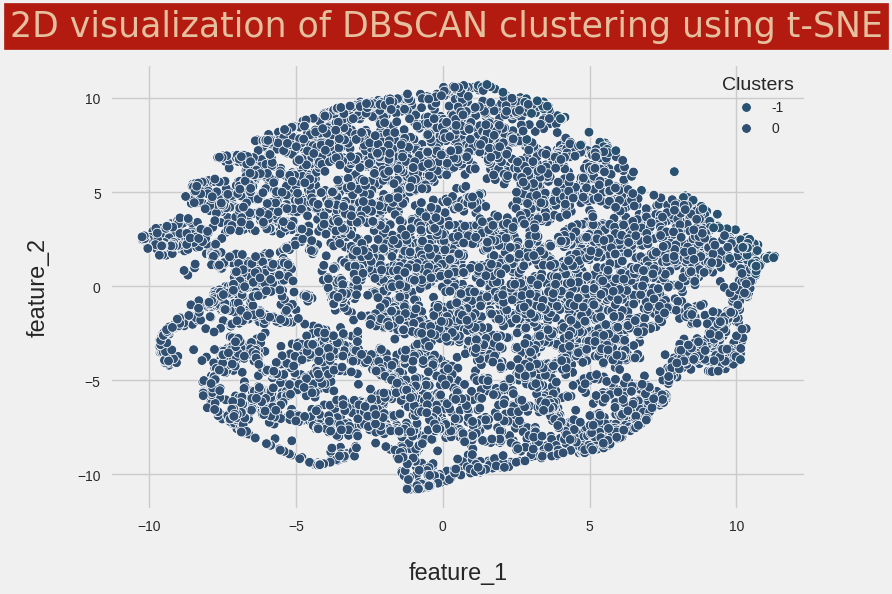

In [ ]:
sns.scatterplot(x='feature_1', y='feature_2', hue='cluster', data=dbscan_tsne_2d, palette=dark_colors[0:2])

plt.xlabel("feature_1", labelpad=20)
plt.ylabel("feature_2", labelpad=20)

plt.legend(title="Clusters", edgecolor = "black")

plt.suptitle(f'2D visualization of DBSCAN clustering using t-SNE', **FONT)

In [ ]:
dbscan_tsne_3d = pd.concat([tsne_df_3, pd.DataFrame({'cluster':pred_dbscan})], axis=1)
dbscan_tsne_3d.head()

,feature_1,feature_2,feature_3,cluster
0,-4.550570,-2.385834,-1.506331,0
1,-0.737630,2.814408,2.014997,0
2,2.650702,1.302480,2.116342,0
3,-3.009447,-1.969769,0.241896,0
4,-4.296540,-0.971823,-4.162506,0


In [ ]:
fig = px.scatter_3d(data_frame= dbscan_tsne_3d, x='feature_1', y='feature_2', z='feature_3', color=dbscan_tsne_3d.cluster.astype('category'), color_discrete_map={-1:dark_colors[0], 0:dark_colors[1]}, opacity=0.6, height=500, title=f'3D visualization of DBSCAN Shift clustring by using TSNE')

fig.update_traces(marker_size=5)

pio.show(fig)

**Clustering analysis**           
In this exploration, we aim to gain a comprehensive understanding of the KMeans, Mean Shift, and DBSCAN models. We'll scrutinize their performance, evaluate the clusters they've identified, and assess how well they align with the underlying data patterns. This in-depth analysis will provide valuable insights into the strengths and weaknesses of each clustering algorithm, aiding in the selection of the most suitable approach for the given dataset.

In [ ]:
kmeans = KMeans(**models.setting[0])
kmeans.fit(df2)

KMeans(init='random', n_clusters=3, n_init=10, random_state=42)

In [ ]:
pred_kmeans = kmeans.labels_

In [ ]:
centroids = kmeans.cluster_centers_
centroids = pd.DataFrame(data=centroids, columns=df2.columns)

In [ ]:
real_centroids = scaler.inverse_transform(centroids)
real_centroids = pd.DataFrame(data=real_centroids, columns=df2.columns)

In [ ]:
kmeans_result_df = pd.concat([df1, pd.DataFrame(pred_kmeans, columns=['cluster'])], axis = 1)
kmeans_result_df

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,1
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,2
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,1
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,379.829982,0.000000,12.0,1
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8944,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,1
8945,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,156.060050,0.000000,6.0,1
8946,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,1
8947,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,1


In [ ]:
centroids

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,0.303944,0.439589,1.511614,1.268264,1.243736,-0.249556,1.141921,1.564646,0.943199,-0.361336,-0.252896,1.665562,0.877590,0.823743,0.154268,0.503755,0.298415
1,-0.367227,-0.179740,-0.234509,-0.206109,-0.175729,-0.308897,-0.066657,-0.240889,-0.049147,-0.333864,-0.298505,-0.246261,-0.337131,-0.285178,-0.138551,0.003822,-0.028490
2,1.166323,0.342575,-0.289383,-0.207014,-0.303986,1.377638,-0.641343,-0.306603,-0.552346,1.560896,1.340504,-0.365267,0.600897,0.444407,0.408962,-0.410046,-0.125249


<ipython-input-36-b259f0639748>:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




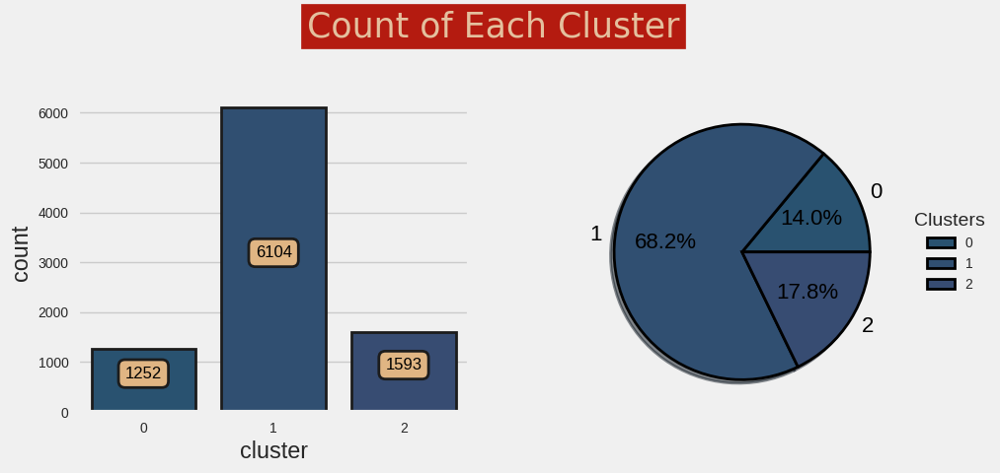

In [ ]:
check_result(kmeans_result_df)

In [ ]:
cluster0_df = kmeans_result_df[kmeans_result_df.cluster == 0]
cluster1_df = kmeans_result_df[kmeans_result_df.cluster == 1]
cluster2_df = kmeans_result_df[kmeans_result_df.cluster == 2]

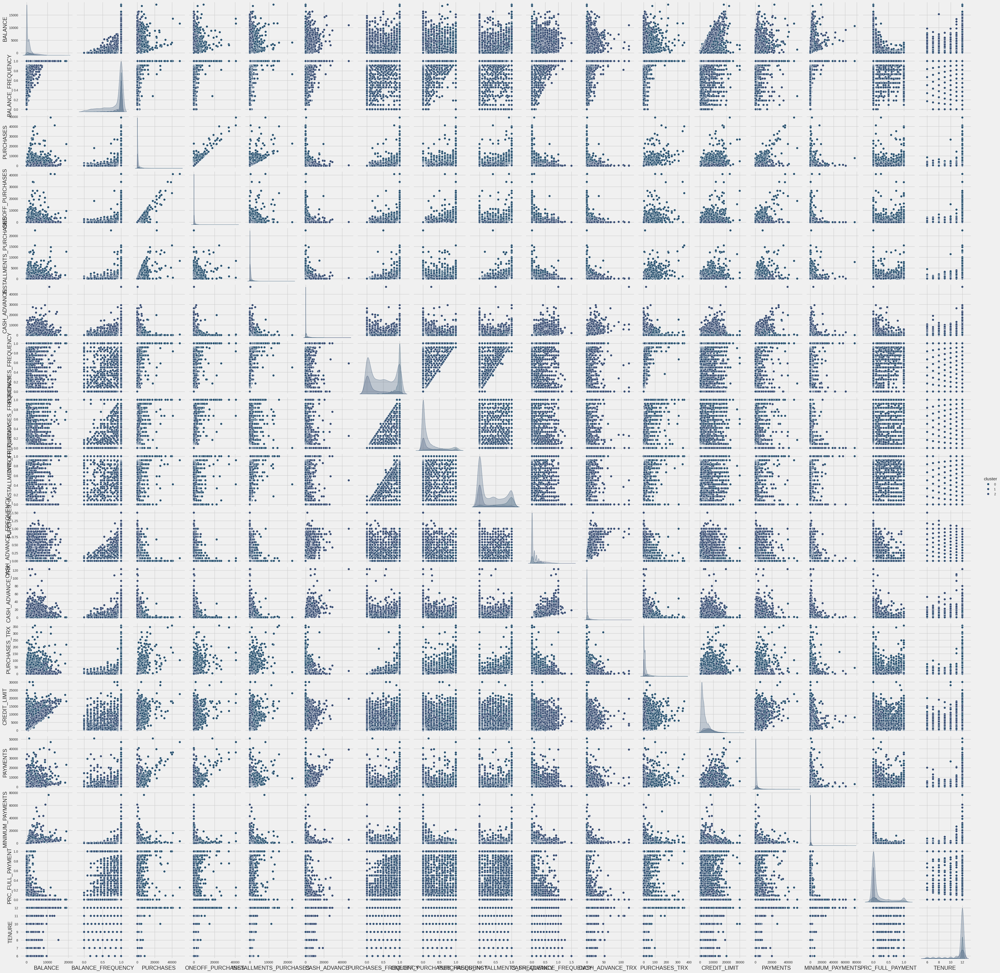

In [ ]:
sns.pairplot(kmeans_result_df, hue='cluster', palette=dark_colors[0:3])

plt.show()

In [ ]:
cols1 = ['BALANCE','BALANCE_FREQUENCY','CASH_ADVANCE','CASH_ADVANCE_FREQUENCY','CASH_ADVANCE_TRX','CREDIT_LIMIT','INSTALLMENTS_PURCHASES','MINIMUM_PAYMENTS','ONEOFF_PURCHASES','ONEOFF_PURCHASES_FREQUENCY','PAYMENTS','PRC_FULL_PAYMENT','PURCHASES_FREQUENCY','PURCHASES_INSTALLMENTS_FREQUENCY','PURCHASES_TRX','TENURE']

def check_scatter(df, name):
    plt.figure(figsize=(20, 20), dpi=200)
    for i, col in enumerate(cols1, 1):
        plt.subplot(4,4,i)
        sns.scatterplot(data=df, x=col, y='purchases', hue='cluster', palette=dark_colors[0:int(df.cluster.nunique())])
        sns.scatterplot(data=real_centroids, x=col, y='purchases', color='black', s=90)
        plt.ylabel("purchases", labelpad=10)
        plt.xlabel(col, labelpad=10)
    plt.suptitle(f"Scatterplot of Features in {name} Clustering", **FONT)
    plt.tight_layout(pad=3.0)
    plt.show()

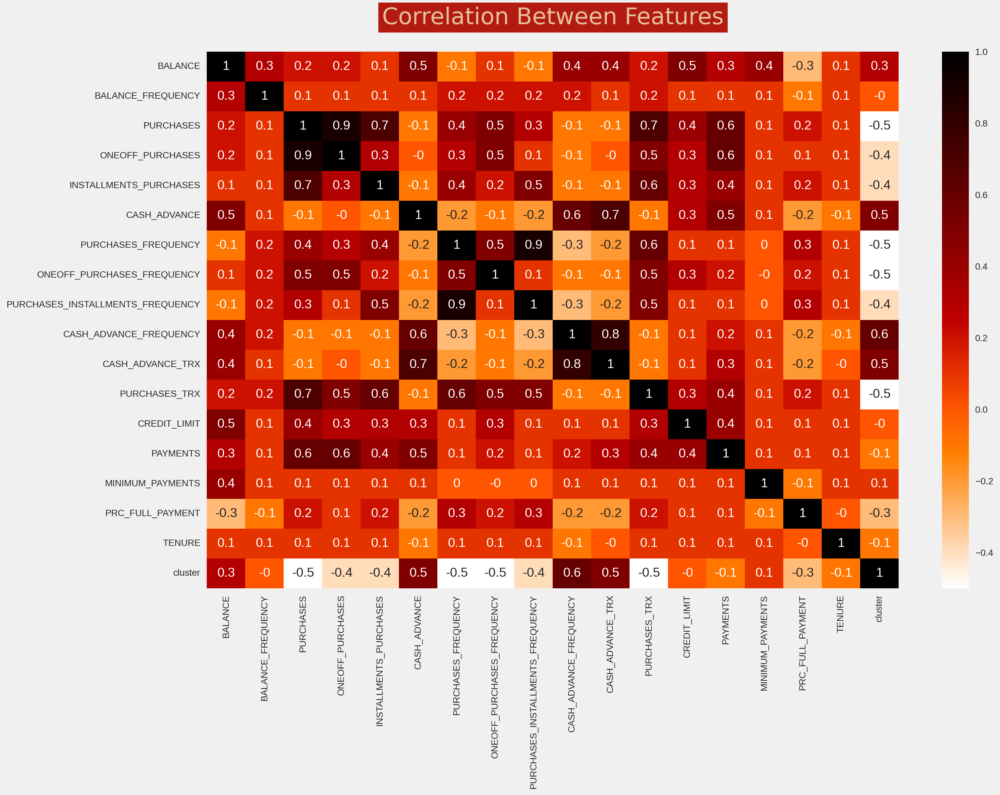

In [ ]:
plt.figure(figsize=(15,10), dpi=200)

sns.heatmap(round(kmeans_result_df.corr(),1),cmap='gist_heat_r', annot=True)

plt.title("Correlation Between Features", pad=30, fontdict=FONT)

plt.show()

The analysis of the aforementioned graphs yields the following insights:     
*   Customers in clusters 1 and 2 exhibit a lower balance, whereas those in cluster 0 maintain a higher balance compared to the other clusters.
*  Cluster 0 customers demonstrate high purchase frequency, both in one-off and installment purchases, while cluster 2 customers exhibit low frequency in both categories.
*  Customers in cluster 1 typically have a lower credit limit than those in the other clusters.
*   Cluster 2 customers often engage in a higher cash advance frequency compared to customers in other clusters.

Based on the KMeans algorithm results, the clusters 0 to 2 can be characterized as follows:
*   Cluster 0: Customers with an average balance who frequently make purchases in any type (one-off or installment).
*   Cluster 1: Customers with low balance and credit limit, less frequently engaging in one-off purchases.

* Cluster 2: Customers with a low balance, infrequently making any type of purchases (one-off or installment), but frequently making cash advances.





**Mean Shift analysis**

In [ ]:
mshift = MeanShift(**models.setting[1])
mshift.fit(df2)

In [ ]:
pred_mshift = mshift.labels_

In [ ]:
centroids = mshift.cluster_centers_
centroids = pd.DataFrame(data=centroids, columns=df2.columns)

In [ ]:
real_centroids = scaler.inverse_transform(centroids)
real_centroids = pd.DataFrame(data=real_centroids, columns=df2.columns)

In [ ]:
mshift_result_df = pd.concat([df1, pd.DataFrame(pred_mshift, columns=['cluster'])], axis = 1)
mshift_result_df

In [ ]:
check_result(mshift_result_df)

In [ ]:
cluster0_df = mshift_result_df[mshift_result_df.cluster == 0]
cluster1_df = mshift_result_df[mshift_result_df.cluster == 1]
cluster2_df = mshift_result_df[mshift_result_df.cluster == 2]
cluster3_df = mshift_result_df[mshift_result_df.cluster == 3]
cluster4_df = mshift_result_df[mshift_result_df.cluster == 4]

In [ ]:
#check_hist(mshift_result_df, 'MeanShift')

In [ ]:
plt.figure(figsize=(15,10), dpi=200)

sns.heatmap(round(mshift_result_df.corr(),1),cmap='gist_heat_r', annot=True)

plt.title("Correlation Between Features", pad=30, fontdict=FONT)

plt.show()

Observing the visualizations above, it's evident that despite the Mean Shift algorithm achieving a high score in the Silhouette criterion, it is not well-suited for this dataset and our intended purpose, as the clustering performance is suboptimal.

 **DBSCAN analysis**

In [ ]:
dbscan = DBSCAN(**models.setting[2])
dbscan.fit(df2)

In [ ]:
pred_dbscan = dbscan.labels_

In [ ]:
dbscan_result_df = pd.concat([df1, pd.DataFrame(pred_dbscan, columns=['cluster'])], axis = 1)
dbscan_result_df

In [ ]:
check_result(dbscan_result_df)

In [ ]:
cluster0_df = kmeans_result_df[kmeans_result_df.cluster == -1]
cluster1_df = kmeans_result_df[kmeans_result_df.cluster == 0]

In [ ]:
#check_hist(dbscan_result_df, 'DBSCAN')

In [ ]:
plt.figure(figsize=(15,10), dpi=200)

sns.heatmap(round(dbscan_result_df.corr(),1),cmap='gist_heat_r', annot=True)

plt.title("Correlation Between Features", pad=30, fontdict=FONT)

plt.show()

The insights derived from the aforementioned graphs and their analysis are as follows:

Cluster -1 encompasses customers with an average balance, exhibiting higher average purchase frequency. On the other hand, Cluster 0 consists of customers with a lower average balance, showcasing lower average one-off purchases frequency and installment purchases frequency.

Moreover, Cluster -1 customers, on average, possess a moderate credit limit, whereas Cluster 0 customers have a lower credit limit, on average.

In summary, based on the results obtained from the KMeans algorithm, clusters 0 to 2 can be characterized as follows:

In Cluster -1, customers with an average balance and low credit limits are observed to be actively involved in frequent purchases, suggesting a consistent spending behavior. Meanwhile, Cluster 0 reveals a subgroup of customers with both low balances and credit limits, indicating a more conservative approach to making one-off or installment purchases, infrequently engaging in such transactions. These nuanced insights into distinct financial profiles enhance our understanding of customer behavior within the dataset.